# Face Generation

In this project, you'll define and train a Generative Adverserial network of your own creation on a dataset of faces. Your goal is to get a generator network to generate *new* images of faces that look as realistic as possible!

The project will be broken down into a series of tasks from **defining new architectures training adversarial networks**. At the end of the notebook, you'll be able to visualize the results of your trained Generator to see how it performs; your generated samples should look like fairly realistic faces with small amounts of noise.

### Get the Data

You'll be using the [CelebFaces Attributes Dataset (CelebA)](http://mmlab.ie.cuhk.edu.hk/projects/CelebA.html) to train your adversarial networks.

This dataset has higher resolution images than datasets you have previously worked with (like MNIST or SVHN) you've been working with, and so, you should prepare to define deeper networks and train them for a longer time to get good results. It is suggested that you utilize a GPU for training.

### Pre-processed Data

Since the project's main focus is on building the GANs, we've done *some* of the pre-processing for you. Each of the CelebA images has been cropped to remove parts of the image that don't include a face, then resized down to 64x64x3 NumPy images. Some sample data is show below.

<img src='assets/processed_face_data.png' width=60% />

> If you are working locally, you can download this data [by clicking here](https://s3.amazonaws.com/video.udacity-data.com/topher/2018/November/5be7eb6f_processed-celeba-small/processed-celeba-small.zip)

This is a zip file that you'll need to extract in the home directory of this notebook for further loading and processing. After extracting the data, you should be left with a directory of data `processed-celeba-small/`.

In [10]:
# loading packages
from glob import glob
from typing import Tuple, Callable, Dict
import matplotlib.pyplot as plt
import numpy as np
import torch
from PIL import Image
from torch.utils.data import DataLoader, Dataset
from torchvision.transforms import Compose, ToTensor
import torchvision.transforms as T
import torch.nn as nn
import tests
import os
from PIL import Image

In [11]:
# define folder with the dataset
data_dir = 'processed_celeba_small/celeba/'

## Data pipeline

The [CelebA](http://mmlab.ie.cuhk.edu.hk/projects/CelebA.html) dataset contains over 200,000 celebrity images with annotations. Since you're going to be generating faces, you won't need the annotations, you'll only need the images. Note that these are color images with [3 color channels (RGB)](https://en.wikipedia.org/wiki/Channel_(digital_image)#RGB_Images) each.

### Pre-process and Load the Data

Since the project's main focus is on building the GANs, we've done *some* of the pre-processing for you. Each of the CelebA images has been cropped to remove parts of the image that don't include a face, then resized down to 64x64x3 NumPy images. This *pre-processed* dataset is a smaller subset of the very large CelebA dataset and contains roughly 30,000 images. 

Your first task consists in building the dataloader. To do so, you need to do the following:
* implement the get_transforms function
* create a custom Dataset class that reads the CelebA data

### Exercise: implement the get_transforms function

The `get_transforms` function should output a [`torchvision.transforms.Compose`](https://pytorch.org/vision/stable/generated/torchvision.transforms.Compose.html#torchvision.transforms.Compose) of different transformations. You have two constraints:
* the function takes a tuple of size as input and should **resize the images** to the input size
* the output images should have values **ranging from -1 to 1**

In [12]:
# define the function to do trasformation of images
def get_transforms(size: Tuple[int, int]) -> Callable:
    """ Transforms to apply to the image."""
    # TODO: edit this function by appening transforms to the below list
    transforms = [T.ToTensor(),T.Resize(size),T.Normalize((0.5,0.5,0.5),(0.5,0.5,0.5))]
    
    return T.Compose(transforms)


In [13]:
# count the number of images
import glob
dir_path = 'processed_celeba_small/celeba/'+'*.jpg'
res = glob.glob(dir_path)
len(res)

32600

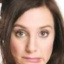

In [14]:
# show an example of an image from database
from PIL import Image
import torchvision.transforms as T
image = Image.open(res[1])
image

### Exercise: implement the DatasetDirectory class


The `DatasetDirectory` class is a torch Dataset that reads from the above data directory. The `__getitem__` method should output a transformed tensor and the `__len__` method should output the number of files in our dataset. You can look at [this custom dataset](https://pytorch.org/tutorials/beginner/basics/data_tutorial.html#creating-a-custom-dataset-for-your-files) for ideas. 

In [15]:
import glob

class DatasetDirectory(Dataset):
    """
    A custom dataset class that loads images from folder.
    args:
    - directory: location of the images
    - transform: transform function to apply to the images
    - extension: file format
    """
    def __init__(self, 
                 directory: str, 
                 transforms: Callable = None, 
                 extension: str = '.jpg'):
        self.directory=directory
        self.extension=extension
        self.transforms=transforms

       # REFER  2_TAO_0
    def __len__(self) -> int:
        """ returns the number of items in the dataset """
        # TODO: return the number of elements in the dataset
        count=0
        for file in os.listdir(self.directory):
            if file[-4:] == self.extension:
                count+=1
        return count
         

    def __getitem__(self, index: int) -> torch.Tensor:
        """ load an image and apply transformation """
        # TODO: return the index-element of the dataset
        dir_path = self.directory+'*.jpg'
        files = glob.glob(dir_path)
        file = Image.open(files[index])
        transform_function = get_transforms((64,64))
        file_tr = transform_function(file)
        #file_tr_sc = scale(file_tr.numpy()) 
        file_tr_sc = file_tr.numpy()
        image_tr_sc_tens = torch.tensor(file_tr_sc)
        return image_tr_sc_tens

In [16]:
# Checking the implementation of DatasetDirectory function
"""
DO NOT MODIFY ANYTHING IN THIS CELL
"""
# run this cell to verify your dataset implementation
dataset = DatasetDirectory(data_dir, get_transforms((64, 64)))
tests.check_dataset_outputs(dataset)

Congrats, your dataset implementation passed all the tests


The functions below will help you visualize images from the dataset.

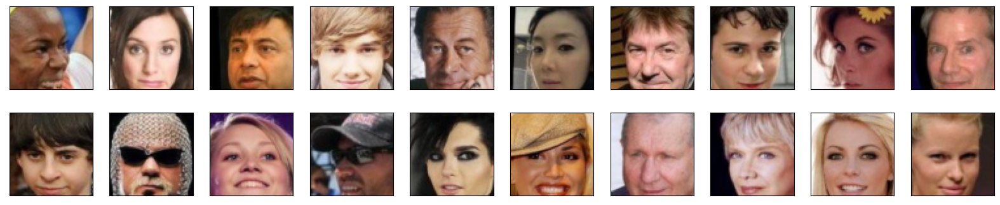

In [17]:
"""
DO NOT MODIFY ANYTHING IN THIS CELL
"""

# function to denormalise iamges for displaying
def denormalize(images):
    """Transform images from [-1.0, 1.0] to [0, 255] and cast them to uint8."""
    return ((images + 1.) / 2. * 255).astype(np.uint8)

# plot the images in the batch, along with the corresponding labels
fig = plt.figure(figsize=(20, 4))
plot_size=20
for idx in np.arange(plot_size):
    ax = fig.add_subplot(2, int(plot_size/2), idx+1, xticks=[], yticks=[])
    img = dataset[idx].numpy()
    img = np.transpose(img, (1, 2, 0))
    img = denormalize(img)
    ax.imshow(img)

## Model implementation

As you know, a GAN is comprised of two adversarial networks, a discriminator and a generator. Now that we have a working data pipeline, we need to implement the discriminator and the generator. 

Feel free to implement any additional class or function.

### Exercise: Create the discriminator

The discriminator's job is to score real and fake images. You have two constraints here:
* the discriminator takes as input a **batch of 64x64x3 images**
* the output should be a single value (=score)

Feel free to get inspiration from the different architectures we talked about in the course, such as DCGAN, WGAN-GP or DRAGAN.

#### Some tips
* To scale down from the input image, you can either use `Conv2d` layers with the correct hyperparameters or Pooling layers.
* If you plan on using gradient penalty, do not use Batch Normalization layers in the discriminator.

In [18]:
from torch.nn import Module

In [19]:
# Creating a convolutional block for Discriminator
# TAKEN FROM 'TRAINING A DEEP CONVOLUTIONAL GANS' SECTION - EXERCISE 'DCGAN TRAINING'
class ConvBlock(Module):
    """
    A convolutional block is made of 3 layers: Conv -> BatchNorm -> Activation.
    args:
    - in_channels: number of channels in the input to the conv layer
    - out_channels: number of filters in the conv layer
    - kernel_size: filter dimension of the conv layer
    - batch_norm: whether to use batch norm or not
    """
    def __init__(self, in_channels: int, out_channels: int, kernel_size: int, batch_norm: bool, stride: int, padding: int):
        super(ConvBlock, self).__init__()
        
        self.conv = nn.Conv2d(in_channels, out_channels, kernel_size, stride, padding, bias=False)
        self.batch_norm = batch_norm
        if self.batch_norm:
            self.bn = nn.BatchNorm2d(out_channels)
        self.activation = nn.LeakyReLU(0.2)
        
    def forward(self, x: torch.Tensor) -> torch.Tensor:
        x = self.conv(x)
        if self.batch_norm:
            x = self.bn(x)
        x = self.activation(x)
        return x

In [20]:
# Creating Discriminator

# BASED ON 'TRAINING A DEEP CONVOLUTIONAL GANS' SECTION - EXERCISE 'DCGAN TRAINING'
    # added additional layer to go from 64x64 to 4x4
conv_dim = 64
class Discriminator(Module):
    def __init__(self, conv_dim: int):
        super(Discriminator, self).__init__()
        # TODO: instantiate the different layers
        # complete init function
        self.conv_dim = conv_dim

        # 64x64 input
        self.conv1 = ConvBlock(3, conv_dim, 4, batch_norm=False, stride=2, padding=1) # first layer, no batch_norm
        # 32x32 out
        self.conv2 = ConvBlock(conv_dim, conv_dim*2, 4, batch_norm=True, stride=2, padding=1)
        # 16x16 out
        self.conv3 = ConvBlock(conv_dim*2, conv_dim*4, 4, batch_norm=True, stride=2, padding=1)
        # 8x8 out
        self.conv4 = ConvBlock(conv_dim*4, conv_dim*8, 4, batch_norm=True, stride=2, padding=1)
        # 4x4 out
       
        self.flatten = nn.Flatten()
        self.fc = nn.Linear(conv_dim*8*4*4, 1)
        # final, fully-connected layer
        
    def forward(self, x: torch.Tensor) -> torch.Tensor:
        # TODO: implement the forward method
        x = self.conv1(x)
        #print( '1: '+ str(x.shape) )
        x = self.conv2(x)
        #print( '2: '+ str(x.shape) )
        x = self.conv3(x)
        #print( '3: '+ str(x.shape) )
        x = self.conv4(x)
        #print( '4: '+ str(x.shape) )
       
        # flatten
        x = self.flatten(x)
        # final output layer
        x = self.fc(x)
        # change dimension to [1,1,1,1]
        x = x[:,None,None, :]
        #print( '5: '+ str(x.shape) )
        return x

In [21]:
# checking discriminator output

torch.manual_seed(0)
images = torch.randn(3, 3, 64, 64)
discriminator = Discriminator(conv_dim)
#discriminator.apply(weights_init)

score = discriminator(images)
print(score.shape)
print(score)

torch.Size([3, 1, 1, 1])
tensor([[[[ 0.2478]]],


        [[[ 0.2862]]],


        [[[-1.3255]]]], grad_fn=<SliceBackward0>)


In [22]:
# doing the tests on the discriminator performance

"""
DO NOT MODIFY ANYTHING IN THIS CELL
"""
# run this cell to check your discriminator implementation
discriminator = Discriminator(conv_dim)
tests.check_discriminator(discriminator)

Congrats, your discriminator implementation passed all the tests


### Exercise: create the generator

The generator's job creates the "fake images" and learns the dataset distribution. You have three constraints here:
* the generator takes as input a vector of dimension `[batch_size, latent_dimension, 1, 1]`
* the generator must outputs **64x64x3 images**

Feel free to get inspiration from the different architectures we talked about in the course, such as DCGAN, WGAN-GP or DRAGAN.

#### Some tips:
* to scale up from the latent vector input, you can use `ConvTranspose2d` layers
* as often with Gan, **Batch Normalization** helps with training

In [23]:
# Creating a deconvolutional block for the Generator

# TAKEN FROM 'TRAINING A DEEP CONVOLUTIONAL GANS' SECTION - EXERCISE 'DCGAN TRAINING'

class DeconvBlock(nn.Module):
    """
    A "de-convolutional" block is made of 3 layers: ConvTranspose -> BatchNorm -> Activation.
    args:
    - in_channels: number of channels in the input to the conv layer
    - out_channels: number of filters in the conv layer
    - kernel_size: filter dimension of the conv layer
    - stride: stride of the conv layer
    - padding: padding of the conv layer
    - batch_norm: whether to use batch norm or not
    """
    def __init__(self, 
                 in_channels: int, 
                 out_channels: int, 
                 kernel_size: int, 
                 stride: int,
                 padding: int,
                 batch_norm: bool = True):
        super(DeconvBlock, self).__init__()
        self.deconv = nn.ConvTranspose2d(in_channels, out_channels, kernel_size, stride, padding, bias=False)
        self.batch_norm = batch_norm
        if self.batch_norm:
            self.bn = nn.BatchNorm2d(out_channels)
        self.activation = nn.ReLU()
        
    def forward(self, x: torch.Tensor) -> torch.Tensor:
        x = self.deconv(x)
        if self.batch_norm:
            x = self.bn(x)
        x = self.activation(x)
        return x

In [24]:
# Creating the Generator

# BASED ON 'TRAINING A DEEP CONVOLUTIONAL GANS' SECTION - EXERCISE 'DCGAN TRAINING'
     # added fc layer to the generator as in https://skysign.github.io/udacity-DLNP/PART%205%20Generative%20Adversarial%20Networks/Project%20Generate%20Faces/dlnd_face_generation.html
     # updated generator so that it started with 2x2 and created a 64x64 image with 3 layers
class Generator(Module):
    def __init__(self, latent_dim: int, conv_dim: int = 64):
        # TODO: instantiate the different layers
        super(Generator, self).__init__()
        # transpose conv layers
        self.fc = nn.Linear(latent_dim, conv_dim*8*4*4)
        self.dropout = nn.Dropout(0.5)
        
        self.deconv1 = DeconvBlock(conv_dim*8, conv_dim*4, 4, 2, 1)
        self.deconv2 = DeconvBlock(conv_dim*4, conv_dim*2, 4, 2, 1)
        self.deconv3 = DeconvBlock(conv_dim*2, conv_dim, 4, 2, 1)
       # self.deconv4 = DeconvBlock(conv_dim, int(conv_dim/2), 4, 2, 1,batch_norm=True)
       # self.Transp2d = torch.nn.ConvTranspose2d(int(conv_dim/2), 3, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)

        self.Transp2d = torch.nn.ConvTranspose2d(int(conv_dim), 3, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
        self.tahn_activation = nn.Tanh()
        
    def forward(self, x):
        # TODO: implement the forward method
        x = self.fc(x)
        #print( '1: '+ str(x.shape) )
        x = self.dropout(x)
        x = x.view(-1, conv_dim*8, 4, 4)
        #print( '2: '+ str(x.shape) )

        x = self.deconv1(x)
        #print( '1: '+ str(x.shape) )
        x = self.deconv2(x)
        #print( '2: '+ str(x.shape) )
        x = self.deconv3(x)
        #print( '3: '+ str(x.shape) )
        #x = self.deconv4(x)
        #print( '4: '+ str(x.shape) )
        x = self.Transp2d(x)
        #print( '5: '+ str(x.shape) )
        x = self.tahn_activation(x)
        return x

In [25]:
# Checking generator output size

onv_dim = 64   
latent_dim = 200
generator = Generator(latent_dim)
latent_vector = torch.randn(1, latent_dim)
latent_vector.size()
image = generator(latent_vector)
image.size()


torch.Size([1, 3, 64, 64])

In [27]:
# doing the test on the generator performance

"""
DO NOT MODIFY ANYTHING IN THIS CELL
"""
def check_generator2(generator: torch.nn.Module, latent_dim: int):
    latent_vector = torch.randn(1, latent_dim)
    image = generator(latent_vector)
    assert image.size() == torch.Size([1, 3, 64, 64]), 'The generator should output a 64x64x3 images.'
    print('Congrats, your generator implementation passed all the tests')
    
    
latent_dim = 128
conv_dim  = 64
generator = Generator(latent_dim, conv_dim)
#generator.apply(weights_init)
check_generator2(generator, latent_dim)

Congrats, your generator implementation passed all the tests


## Optimizer

In the following section, we create the optimizers for the generator and discriminator. You may want to experiment with different optimizers, learning rates and other hyperparameters as they tend to impact the output quality.

### Exercise: implement the optimizers

In [28]:
# setting hyperparameters for optimiser

# OPTIMIZERS ARE ADDED TO THE FINAL LOOP

import torch.optim as optim
lr = 0.0002
beta1=0.1
beta2=0.999 # default value

## Losses implementation

In this section, we are going to implement the loss function for the generator and the discriminator. You can and should experiment with different loss function.

Some tips:
* You can choose the commonly used the binary cross entropy loss or select other losses we have discovered in the course, such as the Wasserstein distance.
* You may want to implement a gradient penalty function as discussed in the course. It is not required and the code will work whether you implement it or not.

### Exercise: implement the generator loss

The generator's goal is to get the discriminator to think its generated images (= "fake" images) are real.

In [29]:
# functions to calculate loss for generator

# TAKEN FROM 'TRAINING A DEEP CONVOLUTIONAL GANS' SECTION - EXERCISE 'DCGAN TRAINING'

def real_loss(D_out, smooth=False):
    batch_size = D_out.size(0)
    # label smoothing
    if smooth:
        # smooth, real labels = 0.9
        labels = torch.ones(batch_size)*0.9
    else:
        labels = torch.ones(batch_size) # real labels = 1
    # move labels to GPU if available     
    if train_on_gpu:
        labels = labels.cuda()
    # binary cross entropy with logits loss
    criterion = nn.BCEWithLogitsLoss()
    # calculate loss
    loss = criterion(D_out.squeeze(), labels)
    return loss

def fake_loss(D_out):
    batch_size = D_out.size(0)
    labels = torch.zeros(batch_size) # fake labels = 0
    if train_on_gpu:
        labels = labels.cuda()
    criterion = nn.BCEWithLogitsLoss()
    # calculate loss
    loss = criterion(D_out.squeeze(), labels)
    return loss

In [32]:
# final function to calculate loss for the generator

# BASED ON 'TRAINING A DEEP CONVOLUTIONAL GANS' SECTION - EXERCISE 'DCGAN TRAINING'

def generator_loss(fake_logits):
    """ Generator loss, takes the fake scores as inputs. """
    loss = real_loss(fake_logits)
    return loss


### Exercise: implement the discriminator loss

We want the discriminator to give high scores to real images and low scores to fake ones and the discriminator loss should reflect that.

In [33]:
# BASED ON 'TRAINING A DEEP CONVOLUTIONAL GANS' SECTION - EXERCISE 'DCGAN TRAINING'

def discriminator_loss(real_logits, fake_logits):
    """ Discriminator loss, takes the fake and real logits as inputs. """
    # TODO: implement the discriminator loss
    d_real_loss = real_loss(real_logits)
    d_fake_loss = fake_loss(fake_logits)
    loss = d_real_loss + d_fake_loss
    return loss

### Exercise (Optional): Implement the gradient Penalty

In the course, we discussed the importance of gradient penalty in training certain types of Gans. Implementing this function is not required and depends on some of the design decision you made (discriminator architecture, loss functions).

In [34]:
def gradient_penalty(discriminator, real_samples, fake_samples):
    """ This function enforces """
    gp = 0
    return gp

## Training


Training will involve alternating between training the discriminator and the generator. You'll use your functions real_loss and fake_loss to help you calculate the discriminator losses.

* You should train the discriminator by alternating on real and fake images
* Then the generator, which tries to trick the discriminator and should have an opposing loss function

### Exercise: implement the generator step and the discriminator step functions

Each function should do the following:
* calculate the loss
* backpropagate the gradient
* perform one optimizer step

In [42]:
# Create functions to make a step in looping through epochs

# BASED ON 'TRAINING A DEEP CONVOLUTIONAL GANS' SECTION - EXERCISE 'DCGAN TRAINING'

def generator_step(batch_size: int, latent_dim: int) -> Dict:
    """ One training step of the generator. """
    # TODO: implement the generator step (foward pass, loss calculation and backward pass)
    generator.train()
    discriminator.train()
    g_optimizer.zero_grad()
    #z = np.random.uniform(-1, 1, size=(batch_size, latent_dim, 1, 1))
    z = np.random.uniform(-1, 1, size=(batch_size, latent_dim))

    z = torch.from_numpy(z).float()
    if train_on_gpu:
        z = z.cuda()
    fake_images = generator(z)
    fake_images_numpy = fake_images.cpu().detach().numpy()
    #print('Generated images /  min: ' + str(fake_images_numpy.min()) + '___max: ' +   str(fake_images_numpy.max()))
    # Compute the discriminator losses on fake images 
    # using flipped labels!
    D_fake = discriminator(fake_images)
    g_loss = generator_loss(D_fake) # use real loss to flip labels    
    g_loss.backward()
    g_optimizer.step()
    return {'loss': g_loss}


def discriminator_step(batch_size: int, latent_dim: int, real_images: torch.Tensor) -> Dict:
    """ One training step of the discriminator. """
    # TODO: implement the discriminator step (foward pass, loss calculation and backward pass)
    generator.train()
    discriminator.train()
    
    d_optimizer.zero_grad()
    if train_on_gpu:
        real_images = real_images.cuda()
    D_real = discriminator(real_images)
    
    #z = np.random.uniform(-1, 1, size=(batch_size, latent_dim, 1, 1))
    z = np.random.uniform(-1, 1, size=(batch_size, latent_dim))
    z = torch.from_numpy(z).float()
    # move x to GPU, if available
    if train_on_gpu:
        z = z.cuda()
    fake_images = generator(z)
    D_fake = discriminator(fake_images.detach())    
        
    d_loss = discriminator_loss(D_real, D_fake)
    d_loss.backward()
    nn.utils.clip_grad_norm_(discriminator.parameters(), max_norm=1.0)
    d_optimizer.step()
    gp=0
    return {'loss': d_loss, 'gp': gp}

### Main training loop

You don't have to implement anything here but you can experiment with different hyperparameters.

In [36]:
from datetime import datetime

In [37]:
# you can experiment with different dimensions of latent spaces
latent_dim = 200

# update to cpu if you do not havea access to a gpu
device = 'cuda'

# number of epochs to train your model
n_epochs = 10

# number of images in each batch
batch_size = 32

conv_dim = 64

In [38]:
"""
DO NOT MODIFY ANYTHING IN THIS CELL
"""
# parameter that defines when you print the performance of the neural network
print_every = 204

# Create optimizers for the discriminator D and generator G
generator = Generator(latent_dim).to(device)
discriminator = Discriminator(conv_dim).to(device)

# get dataloader
dataloader = DataLoader(dataset, 
                        batch_size=batch_size, 
                        shuffle=True, 
                        num_workers=0, 
                        drop_last=True,
                        pin_memory=False)

In [39]:
"""
DO NOT MODIFY ANYTHING IN THIS CELL
"""
# fnction to display the performance of the neural network
def display(fixed_latent_vector: torch.Tensor):
    """ helper function to display images during training """
    fig = plt.figure(figsize=(14, 4))
    plot_size = 16
    for idx in np.arange(plot_size):
        ax = fig.add_subplot(2, int(plot_size/2), idx+1, xticks=[], yticks=[])
        img = fixed_latent_vector[idx, ...].detach().cpu().numpy()
        img = np.transpose(img, (1, 2, 0))
        img = denormalize(img)
        ax.imshow(img)
    plt.show()

### Exercise: implement the training strategy

You should experiment with different training strategies. For example:

* train the generator more often than the discriminator. 
* added noise to the input image
* use label smoothing

Implement with your training strategy below.

In [40]:
# checking the device in use

print(torch.cuda.is_available())
print(torch.cuda.current_device())
print(torch.cuda.get_device_name(0))
print(f"running with device: {torch.cuda.get_device_name(torch.cuda.current_device())}")

# setting device on GPU if available, else CPU
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print('Using device:', device)
print()


True
0
NVIDIA GeForce GTX 1080 Ti
running with device: NVIDIA GeForce GTX 1080 Ti
Using device: cuda



############  batch_i: 0
Generated images /  min: -0.9997332___max: 0.99998593
2023-04-30 15:16:16 | Epoch [1/10] | Batch 0/1018 | d_loss: 1.4770 | g_loss: 0.7040


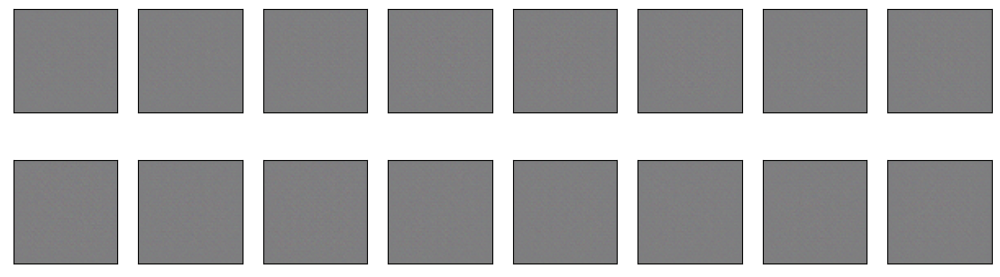

############  batch_i: 1
Generated images /  min: -0.9998258___max: 0.9999923
############  batch_i: 2
Generated images /  min: -0.9995657___max: 0.9999978
############  batch_i: 3
Generated images /  min: -0.9998437___max: 0.9999923
############  batch_i: 4
Generated images /  min: -0.99975926___max: 0.99998903
############  batch_i: 5
Generated images /  min: -0.99989355___max: 0.9999981
############  batch_i: 6
Generated images /  min: -0.99952066___max: 0.99999493
############  batch_i: 7
Generated images /  min: -0.99898714___max: 0.99999607
############  batch_i: 8
Generated images /  min: -0.99938494___max: 0.99999
############  batch_i: 9
Generated images /  min: -0.99958706___max: 0.9999943
############  batch_i: 10
Generated images /  min: -0.9996329___max: 0.99998033
############  batch_i: 11
Generated images /  min: -0.9997734___max: 0.99998426
############  batch_i: 12
Generated images /  min: -0.99920624___max: 0.9999973
############  batch_i: 13
Generated images /  min: 

Generated images /  min: -0.9995342___max: 0.99999994
############  batch_i: 105
Generated images /  min: -0.9994492___max: 1.0
############  batch_i: 106
Generated images /  min: -0.9994991___max: 0.999982
############  batch_i: 107
Generated images /  min: -0.9994956___max: 0.9999999
############  batch_i: 108
Generated images /  min: -0.999201___max: 0.9999899
############  batch_i: 109
Generated images /  min: -0.9994105___max: 0.9999984
############  batch_i: 110
Generated images /  min: -0.99927014___max: 0.9999995
############  batch_i: 111
Generated images /  min: -0.99930036___max: 0.9999998
############  batch_i: 112
Generated images /  min: -0.99916035___max: 0.99999994
############  batch_i: 113
Generated images /  min: -0.9993274___max: 0.99999857
############  batch_i: 114
Generated images /  min: -0.9990488___max: 0.9999985
############  batch_i: 115
Generated images /  min: -0.99936116___max: 0.99998766
############  batch_i: 116
Generated images /  min: -0.99921364___m

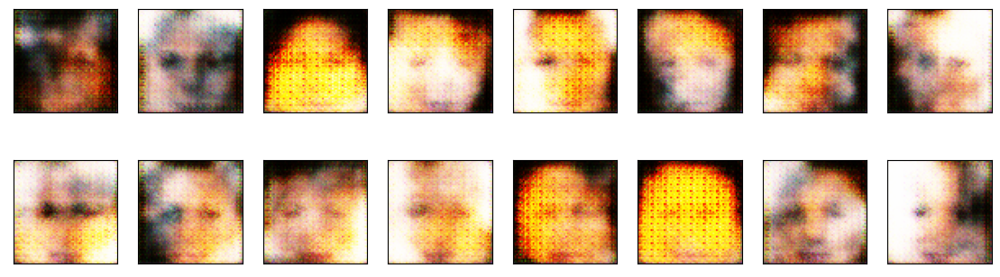

############  batch_i: 205
Generated images /  min: -0.9999536___max: 0.9999905
############  batch_i: 206
Generated images /  min: -0.9998596___max: 0.9999999
############  batch_i: 207
Generated images /  min: -0.99995327___max: 0.99999493
############  batch_i: 208
Generated images /  min: -0.99992883___max: 0.99999595
############  batch_i: 209
Generated images /  min: -0.9999138___max: 0.99999994
############  batch_i: 210
Generated images /  min: -0.9999695___max: 0.9999894
############  batch_i: 211
Generated images /  min: -0.9999459___max: 0.99999857
############  batch_i: 212
Generated images /  min: -0.9998872___max: 0.9999978
############  batch_i: 213
Generated images /  min: -0.9999212___max: 0.9999979
############  batch_i: 214
Generated images /  min: -0.9998747___max: 0.9999986
############  batch_i: 215
Generated images /  min: -0.99988216___max: 0.9999996
############  batch_i: 216
Generated images /  min: -0.9999244___max: 0.9999997
############  batch_i: 217
Genera

Generated images /  min: -0.9999988___max: 0.99997
############  batch_i: 308
Generated images /  min: -0.99999297___max: 0.9998748
############  batch_i: 309
Generated images /  min: -0.9999958___max: 0.99993193
############  batch_i: 310
Generated images /  min: -0.99999976___max: 0.9999932
############  batch_i: 311
Generated images /  min: -0.999999___max: 0.9998776
############  batch_i: 312
Generated images /  min: -0.99999434___max: 0.9999775
############  batch_i: 313
Generated images /  min: -0.9999999___max: 0.9999096
############  batch_i: 314
Generated images /  min: -0.99998796___max: 0.9999807
############  batch_i: 315
Generated images /  min: -0.9999963___max: 0.99996346
############  batch_i: 316
Generated images /  min: -0.9999996___max: 0.9999655
############  batch_i: 317
Generated images /  min: -0.99999577___max: 0.9999538
############  batch_i: 318
Generated images /  min: -0.99997956___max: 0.9999642
############  batch_i: 319
Generated images /  min: -0.9999985

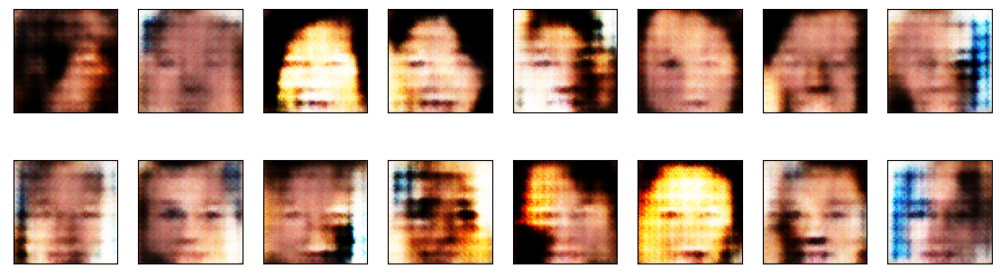

############  batch_i: 409
Generated images /  min: -0.9999991___max: 0.99999565
############  batch_i: 410
Generated images /  min: -0.9999877___max: 0.9999922
############  batch_i: 411
Generated images /  min: -0.99999386___max: 0.9999636
############  batch_i: 412
Generated images /  min: -0.9999947___max: 0.99976695
############  batch_i: 413
Generated images /  min: -0.99999785___max: 0.99980813
############  batch_i: 414
Generated images /  min: -0.99999124___max: 0.9999319
############  batch_i: 415
Generated images /  min: -0.9999998___max: 0.99997306
############  batch_i: 416
Generated images /  min: -0.9999999___max: 0.9999234
############  batch_i: 417
Generated images /  min: -0.9999987___max: 0.9999591
############  batch_i: 418
Generated images /  min: -0.99998504___max: 0.99997836
############  batch_i: 419
Generated images /  min: -0.99999946___max: 0.9999796
############  batch_i: 420
Generated images /  min: -0.99999976___max: 0.99975526
############  batch_i: 421
G

Generated images /  min: -0.9999999___max: 0.9992331
############  batch_i: 512
Generated images /  min: -0.99998486___max: 0.99997646
############  batch_i: 513
Generated images /  min: -0.99999005___max: 0.9996967
############  batch_i: 514
Generated images /  min: -1.0___max: 0.99961585
############  batch_i: 515
Generated images /  min: -0.9999995___max: 0.99986774
############  batch_i: 516
Generated images /  min: -0.9999965___max: 0.997483
############  batch_i: 517
Generated images /  min: -0.9999859___max: 0.9997689
############  batch_i: 518
Generated images /  min: -0.99999994___max: 0.9999408
############  batch_i: 519
Generated images /  min: -0.99999815___max: 0.999608
############  batch_i: 520
Generated images /  min: -0.99999875___max: 0.9992659
############  batch_i: 521
Generated images /  min: -0.9999909___max: 0.9996515
############  batch_i: 522
Generated images /  min: -0.99999976___max: 0.9992359
############  batch_i: 523
Generated images /  min: -0.9999938___m

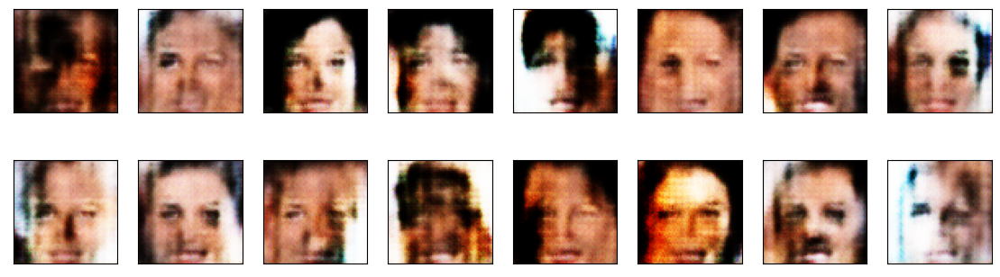

############  batch_i: 613
Generated images /  min: -0.999999___max: 0.99447376
############  batch_i: 614
Generated images /  min: -0.99999803___max: 0.9989502
############  batch_i: 615
Generated images /  min: -0.99999774___max: 0.99662405
############  batch_i: 616
Generated images /  min: -0.99999475___max: 0.99485916
############  batch_i: 617
Generated images /  min: -0.9999988___max: 0.99896246
############  batch_i: 618
Generated images /  min: -0.99997985___max: 0.99913293
############  batch_i: 619
Generated images /  min: -0.9999992___max: 0.99912083
############  batch_i: 620
Generated images /  min: -0.9999939___max: 0.99787503
############  batch_i: 621
Generated images /  min: -0.9999879___max: 0.99807805
############  batch_i: 622
Generated images /  min: -0.9999812___max: 0.9949487
############  batch_i: 623
Generated images /  min: -0.9999972___max: 0.9999082
############  batch_i: 624
Generated images /  min: -0.99999803___max: 0.99939436
############  batch_i: 625


Generated images /  min: -1.0___max: 0.9987374
############  batch_i: 716
Generated images /  min: -0.9999988___max: 0.99792445
############  batch_i: 717
Generated images /  min: -0.9999999___max: 0.9994501
############  batch_i: 718
Generated images /  min: -0.9999976___max: 0.99980724
############  batch_i: 719
Generated images /  min: -0.99999815___max: 0.99930525
############  batch_i: 720
Generated images /  min: -0.99999___max: 0.998705
############  batch_i: 721
Generated images /  min: -0.99999905___max: 0.99923074
############  batch_i: 722
Generated images /  min: -0.99999696___max: 0.99609196
############  batch_i: 723
Generated images /  min: -0.9999928___max: 0.99913806
############  batch_i: 724
Generated images /  min: -0.99999875___max: 0.9990762
############  batch_i: 725
Generated images /  min: -0.9999999___max: 0.9965024
############  batch_i: 726
Generated images /  min: -0.9999959___max: 0.99708605
############  batch_i: 727
Generated images /  min: -0.9999791___

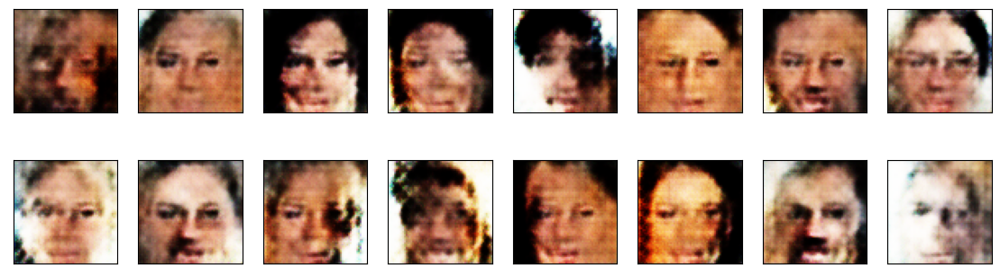

############  batch_i: 817
Generated images /  min: -0.99999946___max: 0.99906486
############  batch_i: 818
Generated images /  min: -0.9999993___max: 0.999817
############  batch_i: 819
Generated images /  min: -0.99999946___max: 0.99860716
############  batch_i: 820
Generated images /  min: -0.999987___max: 0.998597
############  batch_i: 821
Generated images /  min: -0.9999998___max: 0.99733955
############  batch_i: 822
Generated images /  min: -0.9999969___max: 0.99956435
############  batch_i: 823
Generated images /  min: -0.99996257___max: 0.9992706
############  batch_i: 824
Generated images /  min: -0.99999976___max: 0.9990638
############  batch_i: 825
Generated images /  min: -0.99999803___max: 0.9988095
############  batch_i: 826
Generated images /  min: -0.9999998___max: 0.99817276
############  batch_i: 827
Generated images /  min: -0.99999994___max: 0.9969343
############  batch_i: 828
Generated images /  min: -1.0___max: 0.9955781
############  batch_i: 829
Generated i

Generated images /  min: -0.9999986___max: 0.9884474
############  batch_i: 920
Generated images /  min: -0.9999997___max: 0.99488604
############  batch_i: 921
Generated images /  min: -0.9999998___max: 0.9944201
############  batch_i: 922
Generated images /  min: -0.9999988___max: 0.9984905
############  batch_i: 923
Generated images /  min: -1.0___max: 0.9985313
############  batch_i: 924
Generated images /  min: -0.99999994___max: 0.9945466
############  batch_i: 925
Generated images /  min: -0.99999994___max: 0.98786986
############  batch_i: 926
Generated images /  min: -1.0___max: 0.99993706
############  batch_i: 927
Generated images /  min: -1.0___max: 0.99498814
############  batch_i: 928
Generated images /  min: -1.0___max: 0.99943864
############  batch_i: 929
Generated images /  min: -0.9999999___max: 0.99902743
############  batch_i: 930
Generated images /  min: -1.0___max: 0.99877
############  batch_i: 931
Generated images /  min: -0.9999996___max: 0.99797916
##########

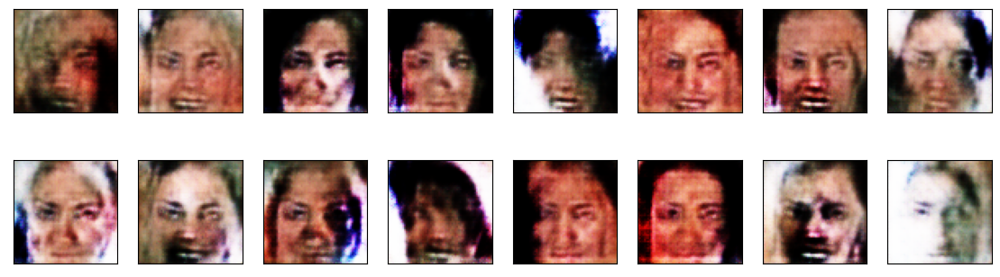

############  batch_i: 1
Generated images /  min: -0.9999998___max: 0.99947536
############  batch_i: 2
Generated images /  min: -0.99999875___max: 0.9992127
############  batch_i: 3
Generated images /  min: -0.99999475___max: 0.99864554
############  batch_i: 4
Generated images /  min: -0.99999917___max: 0.9982056
############  batch_i: 5
Generated images /  min: -0.9999876___max: 0.994575
############  batch_i: 6
Generated images /  min: -1.0___max: 0.99145526
############  batch_i: 7
Generated images /  min: -0.99999994___max: 0.9998931
############  batch_i: 8
Generated images /  min: -0.9999985___max: 0.99911845
############  batch_i: 9
Generated images /  min: -1.0___max: 0.99788284
############  batch_i: 10
Generated images /  min: -1.0___max: 0.99966556
############  batch_i: 11
Generated images /  min: -0.9999948___max: 0.99893457
############  batch_i: 12
Generated images /  min: -0.99999917___max: 0.99424946
############  batch_i: 13
Generated images /  min: -0.99999726___ma

Generated images /  min: -0.99999946___max: 0.9893994
############  batch_i: 107
Generated images /  min: -0.9999992___max: 0.98594165
############  batch_i: 108
Generated images /  min: -0.9999998___max: 0.9943143
############  batch_i: 109
Generated images /  min: -0.9999998___max: 0.99290895
############  batch_i: 110
Generated images /  min: -0.99999994___max: 0.98929644
############  batch_i: 111
Generated images /  min: -0.99999976___max: 0.99397206
############  batch_i: 112
Generated images /  min: -0.99999964___max: 0.9988482
############  batch_i: 113
Generated images /  min: -0.9999998___max: 0.99318784
############  batch_i: 114
Generated images /  min: -1.0___max: 0.99730754
############  batch_i: 115
Generated images /  min: -0.9999999___max: 0.98689675
############  batch_i: 116
Generated images /  min: -0.9999962___max: 0.9834878
############  batch_i: 117
Generated images /  min: -0.9999984___max: 0.9993929
############  batch_i: 118
Generated images /  min: -1.0___max

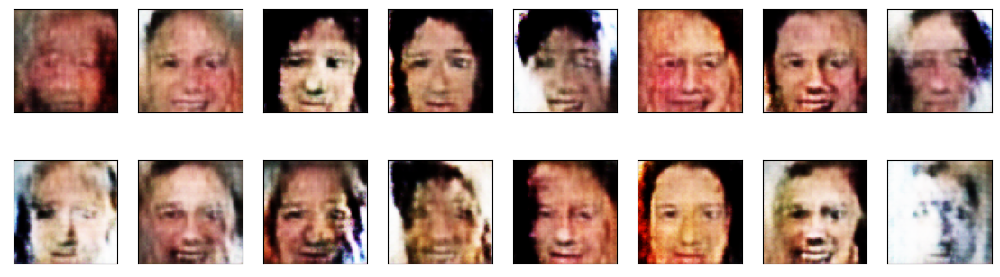

############  batch_i: 205
Generated images /  min: -1.0___max: 0.9957352
############  batch_i: 206
Generated images /  min: -1.0___max: 0.9931129
############  batch_i: 207
Generated images /  min: -0.9999996___max: 0.99984974
############  batch_i: 208
Generated images /  min: -1.0___max: 0.9997677
############  batch_i: 209
Generated images /  min: -1.0___max: 0.9964828
############  batch_i: 210
Generated images /  min: -0.9999997___max: 0.99484307
############  batch_i: 211
Generated images /  min: -0.99999964___max: 0.99062717
############  batch_i: 212
Generated images /  min: -0.9999991___max: 0.9983128
############  batch_i: 213
Generated images /  min: -0.99999994___max: 0.9903338
############  batch_i: 214
Generated images /  min: -0.9999999___max: 0.99991846
############  batch_i: 215
Generated images /  min: -1.0___max: 0.9982494
############  batch_i: 216
Generated images /  min: -1.0___max: 0.9873526
############  batch_i: 217
Generated images /  min: -1.0___max: 0.9959

Generated images /  min: -0.9999998___max: 0.9927193
############  batch_i: 313
Generated images /  min: -1.0___max: 0.9998438
############  batch_i: 314
Generated images /  min: -0.9999999___max: 0.99876946
############  batch_i: 315
Generated images /  min: -0.9999998___max: 0.9916493
############  batch_i: 316
Generated images /  min: -0.99999917___max: 0.9992562
############  batch_i: 317
Generated images /  min: -0.9999992___max: 0.99902534
############  batch_i: 318
Generated images /  min: -1.0___max: 0.9986687
############  batch_i: 319
Generated images /  min: -0.9999998___max: 0.9988307
############  batch_i: 320
Generated images /  min: -0.9999993___max: 0.99595886
############  batch_i: 321
Generated images /  min: -0.99999994___max: 0.9959448
############  batch_i: 322
Generated images /  min: -0.99999994___max: 0.9994003
############  batch_i: 323
Generated images /  min: -0.99999994___max: 0.9996592
############  batch_i: 324
Generated images /  min: -0.9999997___max: 0.

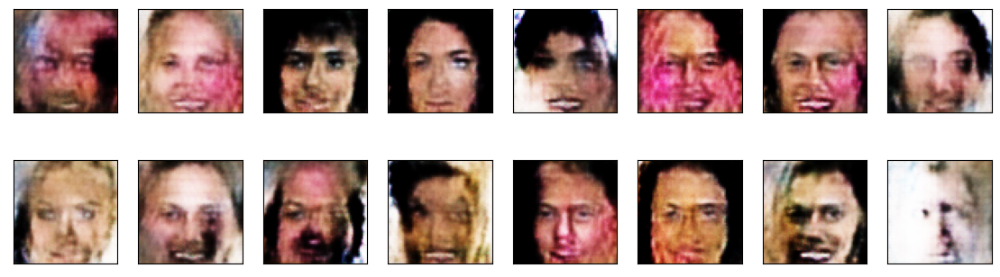

############  batch_i: 409
Generated images /  min: -1.0___max: 0.99344575
############  batch_i: 410
Generated images /  min: -1.0___max: 0.9906919
############  batch_i: 411
Generated images /  min: -1.0___max: 0.9968942
############  batch_i: 412
Generated images /  min: -0.99999994___max: 0.99682033
############  batch_i: 413
Generated images /  min: -1.0___max: 0.99936515
############  batch_i: 414
Generated images /  min: -1.0___max: 0.999239
############  batch_i: 415
Generated images /  min: -1.0___max: 0.99831903
############  batch_i: 416
Generated images /  min: -1.0___max: 0.9986421
############  batch_i: 417
Generated images /  min: -0.99999994___max: 0.9982304
############  batch_i: 418
Generated images /  min: -1.0___max: 0.9972268
############  batch_i: 419
Generated images /  min: -0.9999999___max: 0.9913096
############  batch_i: 420
Generated images /  min: -1.0___max: 0.9987382
############  batch_i: 421
Generated images /  min: -0.99999976___max: 0.99933815
#######

Generated images /  min: -1.0___max: 0.99799633
############  batch_i: 518
Generated images /  min: -1.0___max: 0.9985123
############  batch_i: 519
Generated images /  min: -1.0___max: 0.9960582
############  batch_i: 520
Generated images /  min: -1.0___max: 0.9971039
############  batch_i: 521
Generated images /  min: -1.0___max: 0.9961354
############  batch_i: 522
Generated images /  min: -1.0___max: 0.999222
############  batch_i: 523
Generated images /  min: -0.99999994___max: 0.999232
############  batch_i: 524
Generated images /  min: -1.0___max: 0.997356
############  batch_i: 525
Generated images /  min: -1.0___max: 0.99910295
############  batch_i: 526
Generated images /  min: -0.9999999___max: 0.9966914
############  batch_i: 527
Generated images /  min: -1.0___max: 0.99745744
############  batch_i: 528
Generated images /  min: -1.0___max: 0.9978495
############  batch_i: 529
Generated images /  min: -1.0___max: 0.9924362
############  batch_i: 530
Generated images /  min: 

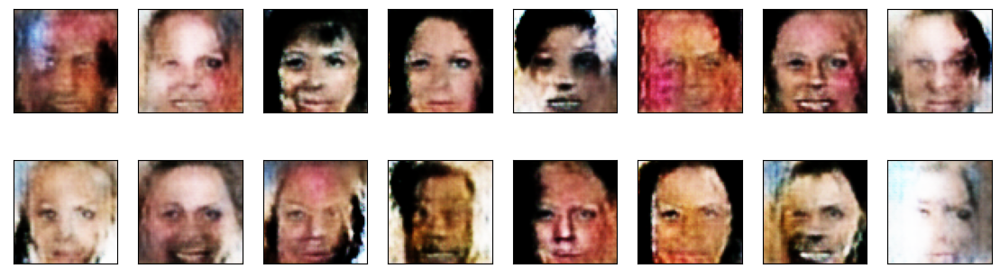

############  batch_i: 613
Generated images /  min: -1.0___max: 0.98811406
############  batch_i: 614
Generated images /  min: -1.0___max: 0.99798375
############  batch_i: 615
Generated images /  min: -1.0___max: 0.9883789
############  batch_i: 616
Generated images /  min: -0.99999976___max: 0.9979218
############  batch_i: 617
Generated images /  min: -0.99999976___max: 0.9937104
############  batch_i: 618
Generated images /  min: -0.99999994___max: 0.9978169
############  batch_i: 619
Generated images /  min: -1.0___max: 0.9829999
############  batch_i: 620
Generated images /  min: -0.9999999___max: 0.98872465
############  batch_i: 621
Generated images /  min: -1.0___max: 0.992052
############  batch_i: 622
Generated images /  min: -1.0___max: 0.99516654
############  batch_i: 623
Generated images /  min: -1.0___max: 0.99500954
############  batch_i: 624
Generated images /  min: -1.0___max: 0.9895287
############  batch_i: 625
Generated images /  min: -1.0___max: 0.9775886
#######

Generated images /  min: -1.0___max: 0.9973328
############  batch_i: 723
Generated images /  min: -1.0___max: 0.9956528
############  batch_i: 724
Generated images /  min: -1.0___max: 0.9819706
############  batch_i: 725
Generated images /  min: -1.0___max: 0.9949434
############  batch_i: 726
Generated images /  min: -1.0___max: 0.97842866
############  batch_i: 727
Generated images /  min: -0.9999999___max: 0.99400985
############  batch_i: 728
Generated images /  min: -1.0___max: 0.9938764
############  batch_i: 729
Generated images /  min: -1.0___max: 0.99389404
############  batch_i: 730
Generated images /  min: -1.0___max: 0.98604524
############  batch_i: 731
Generated images /  min: -1.0___max: 0.9627228
############  batch_i: 732
Generated images /  min: -1.0___max: 0.99522394
############  batch_i: 733
Generated images /  min: -1.0___max: 0.9837816
############  batch_i: 734
Generated images /  min: -1.0___max: 0.9744079
############  batch_i: 735
Generated images /  min: -1

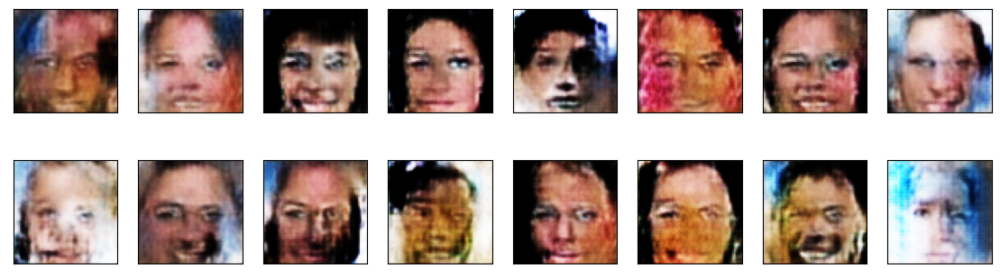

############  batch_i: 817
Generated images /  min: -1.0___max: 0.9960145
############  batch_i: 818
Generated images /  min: -1.0___max: 0.99299973
############  batch_i: 819
Generated images /  min: -1.0___max: 0.9928443
############  batch_i: 820
Generated images /  min: -1.0___max: 0.99106014
############  batch_i: 821
Generated images /  min: -1.0___max: 0.9989206
############  batch_i: 822
Generated images /  min: -1.0___max: 0.99332786
############  batch_i: 823
Generated images /  min: -1.0___max: 0.9906219
############  batch_i: 824
Generated images /  min: -1.0___max: 0.9975332
############  batch_i: 825
Generated images /  min: -1.0___max: 0.99293023
############  batch_i: 826
Generated images /  min: -1.0___max: 0.98904413
############  batch_i: 827
Generated images /  min: -1.0___max: 0.9985
############  batch_i: 828
Generated images /  min: -1.0___max: 0.99481124
############  batch_i: 829
Generated images /  min: -1.0___max: 0.99383014
############  batch_i: 830
Generat

Generated images /  min: -1.0___max: 0.99928576
############  batch_i: 928
Generated images /  min: -1.0___max: 0.99935234
############  batch_i: 929
Generated images /  min: -1.0___max: 0.9687713
############  batch_i: 930
Generated images /  min: -1.0___max: 0.9859482
############  batch_i: 931
Generated images /  min: -1.0___max: 0.9945483
############  batch_i: 932
Generated images /  min: -1.0___max: 0.99689883
############  batch_i: 933
Generated images /  min: -1.0___max: 0.9961837
############  batch_i: 934
Generated images /  min: -1.0___max: 0.9979261
############  batch_i: 935
Generated images /  min: -1.0___max: 0.98246586
############  batch_i: 936
Generated images /  min: -1.0___max: 0.99349135
############  batch_i: 937
Generated images /  min: -1.0___max: 0.9905267
############  batch_i: 938
Generated images /  min: -1.0___max: 0.998405
############  batch_i: 939
Generated images /  min: -1.0___max: 0.9963721
############  batch_i: 940
Generated images /  min: -1.0___ma

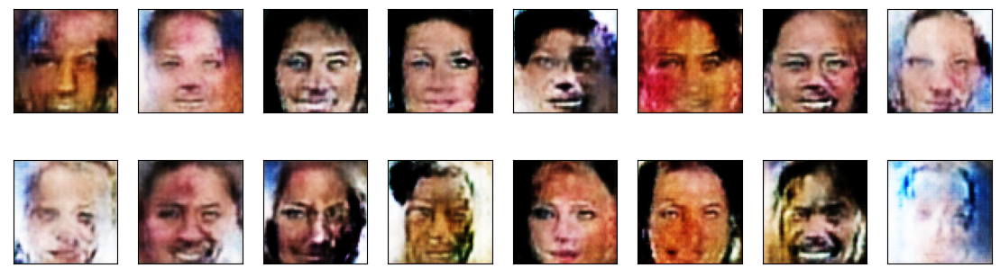

############  batch_i: 1
Generated images /  min: -1.0___max: 0.9876117
############  batch_i: 2
Generated images /  min: -1.0___max: 0.98946327
############  batch_i: 3
Generated images /  min: -1.0___max: 0.99208355
############  batch_i: 4
Generated images /  min: -1.0___max: 0.9972545
############  batch_i: 5
Generated images /  min: -1.0___max: 0.9747277
############  batch_i: 6
Generated images /  min: -1.0___max: 0.990297
############  batch_i: 7
Generated images /  min: -1.0___max: 0.9890094
############  batch_i: 8
Generated images /  min: -1.0___max: 0.9889028
############  batch_i: 9
Generated images /  min: -1.0___max: 0.98272866
############  batch_i: 10
Generated images /  min: -1.0___max: 0.9963873
############  batch_i: 11
Generated images /  min: -1.0___max: 0.99844414
############  batch_i: 12
Generated images /  min: -1.0___max: 0.987959
############  batch_i: 13
Generated images /  min: -1.0___max: 0.99110997
############  batch_i: 14
Generated images /  min: -1.0__

Generated images /  min: -1.0___max: 0.99421185
############  batch_i: 113
Generated images /  min: -1.0___max: 0.99664867
############  batch_i: 114
Generated images /  min: -1.0___max: 0.98789513
############  batch_i: 115
Generated images /  min: -1.0___max: 0.98707056
############  batch_i: 116
Generated images /  min: -1.0___max: 0.9963683
############  batch_i: 117
Generated images /  min: -1.0___max: 0.9894121
############  batch_i: 118
Generated images /  min: -1.0___max: 0.9989164
############  batch_i: 119
Generated images /  min: -1.0___max: 0.9946619
############  batch_i: 120
Generated images /  min: -1.0___max: 0.998486
############  batch_i: 121
Generated images /  min: -1.0___max: 0.9961248
############  batch_i: 122
Generated images /  min: -1.0___max: 0.9975437
############  batch_i: 123
Generated images /  min: -1.0___max: 0.9995439
############  batch_i: 124
Generated images /  min: -1.0___max: 0.9981792
############  batch_i: 125
Generated images /  min: -1.0___max

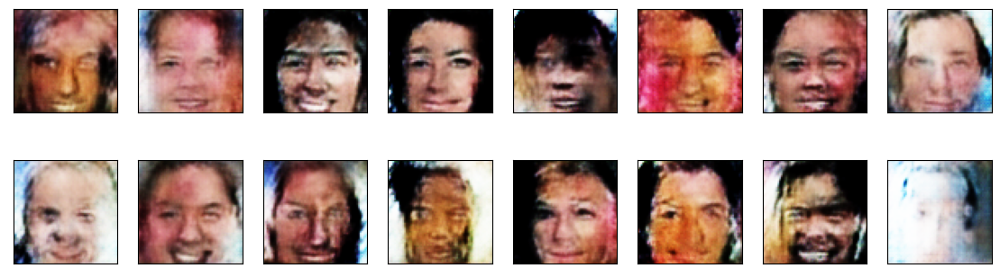

############  batch_i: 205
Generated images /  min: -1.0___max: 0.98558855
############  batch_i: 206
Generated images /  min: -1.0___max: 0.9825744
############  batch_i: 207
Generated images /  min: -1.0___max: 0.99374586
############  batch_i: 208
Generated images /  min: -1.0___max: 0.99304307
############  batch_i: 209
Generated images /  min: -1.0___max: 0.9764563
############  batch_i: 210
Generated images /  min: -1.0___max: 0.9924569
############  batch_i: 211
Generated images /  min: -1.0___max: 0.9990387
############  batch_i: 212
Generated images /  min: -1.0___max: 0.9861374
############  batch_i: 213
Generated images /  min: -1.0___max: 0.98599416
############  batch_i: 214
Generated images /  min: -1.0___max: 0.98064756
############  batch_i: 215
Generated images /  min: -1.0___max: 0.9906231
############  batch_i: 216
Generated images /  min: -1.0___max: 0.9928677
############  batch_i: 217
Generated images /  min: -1.0___max: 0.98693967
############  batch_i: 218
Gener

Generated images /  min: -1.0___max: 0.99318606
############  batch_i: 316
Generated images /  min: -1.0___max: 0.96124774
############  batch_i: 317
Generated images /  min: -1.0___max: 0.97037727
############  batch_i: 318
Generated images /  min: -1.0___max: 0.99140376
############  batch_i: 319
Generated images /  min: -1.0___max: 0.9833568
############  batch_i: 320
Generated images /  min: -1.0___max: 0.9512558
############  batch_i: 321
Generated images /  min: -1.0___max: 0.97129965
############  batch_i: 322
Generated images /  min: -1.0___max: 0.9826677
############  batch_i: 323
Generated images /  min: -1.0___max: 0.98322576
############  batch_i: 324
Generated images /  min: -1.0___max: 0.9771447
############  batch_i: 325
Generated images /  min: -1.0___max: 0.98142546
############  batch_i: 326
Generated images /  min: -1.0___max: 0.9465543
############  batch_i: 327
Generated images /  min: -1.0___max: 0.96128887
############  batch_i: 328
Generated images /  min: -1.0_

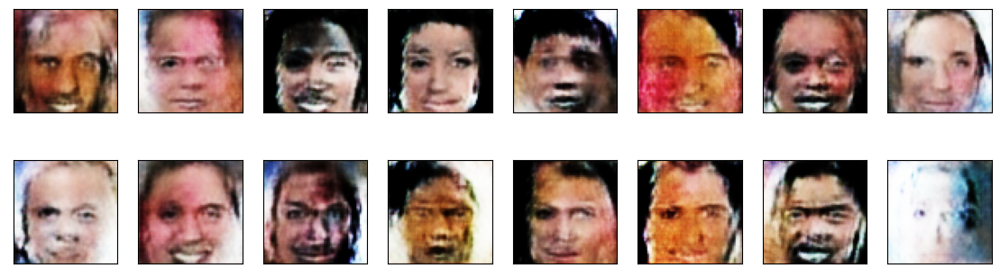

############  batch_i: 409
Generated images /  min: -1.0___max: 0.9762274
############  batch_i: 410
Generated images /  min: -1.0___max: 0.98564446
############  batch_i: 411
Generated images /  min: -1.0___max: 0.9943928
############  batch_i: 412
Generated images /  min: -1.0___max: 0.99334395
############  batch_i: 413
Generated images /  min: -1.0___max: 0.9934074
############  batch_i: 414
Generated images /  min: -1.0___max: 0.9672519
############  batch_i: 415
Generated images /  min: -1.0___max: 0.9840517
############  batch_i: 416
Generated images /  min: -1.0___max: 0.99812114
############  batch_i: 417
Generated images /  min: -1.0___max: 0.9833268
############  batch_i: 418
Generated images /  min: -1.0___max: 0.96449274
############  batch_i: 419
Generated images /  min: -1.0___max: 0.973944
############  batch_i: 420
Generated images /  min: -1.0___max: 0.99225146
############  batch_i: 421
Generated images /  min: -1.0___max: 0.9970767
############  batch_i: 422
Generat

Generated images /  min: -1.0___max: 0.9968978
############  batch_i: 520
Generated images /  min: -1.0___max: 0.980383
############  batch_i: 521
Generated images /  min: -1.0___max: 0.9911572
############  batch_i: 522
Generated images /  min: -1.0___max: 0.9917005
############  batch_i: 523
Generated images /  min: -1.0___max: 0.9825171
############  batch_i: 524
Generated images /  min: -1.0___max: 0.9945786
############  batch_i: 525
Generated images /  min: -1.0___max: 0.9822203
############  batch_i: 526
Generated images /  min: -1.0___max: 0.98145753
############  batch_i: 527
Generated images /  min: -1.0___max: 0.9964044
############  batch_i: 528
Generated images /  min: -1.0___max: 0.99815106
############  batch_i: 529
Generated images /  min: -1.0___max: 0.97144747
############  batch_i: 530
Generated images /  min: -1.0___max: 0.9789711
############  batch_i: 531
Generated images /  min: -1.0___max: 0.98655
############  batch_i: 532
Generated images /  min: -1.0___max: 0

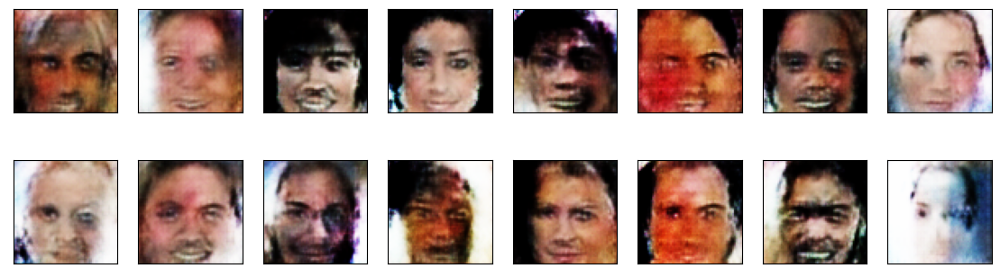

############  batch_i: 613
Generated images /  min: -1.0___max: 0.99670565
############  batch_i: 614
Generated images /  min: -1.0___max: 0.9927575
############  batch_i: 615
Generated images /  min: -1.0___max: 0.9998076
############  batch_i: 616
Generated images /  min: -1.0___max: 0.99728346
############  batch_i: 617
Generated images /  min: -1.0___max: 0.9983211
############  batch_i: 618
Generated images /  min: -1.0___max: 0.99760854
############  batch_i: 619
Generated images /  min: -1.0___max: 0.9882399
############  batch_i: 620
Generated images /  min: -1.0___max: 0.97904617
############  batch_i: 621
Generated images /  min: -1.0___max: 0.9943553
############  batch_i: 622
Generated images /  min: -1.0___max: 0.99941194
############  batch_i: 623
Generated images /  min: -1.0___max: 0.9996689
############  batch_i: 624
Generated images /  min: -1.0___max: 0.99162585
############  batch_i: 625
Generated images /  min: -1.0___max: 0.98302084
############  batch_i: 626
Gene

Generated images /  min: -1.0___max: 0.9909278
############  batch_i: 724
Generated images /  min: -1.0___max: 0.97784513
############  batch_i: 725
Generated images /  min: -1.0___max: 0.9940825
############  batch_i: 726
Generated images /  min: -1.0___max: 0.9937831
############  batch_i: 727
Generated images /  min: -1.0___max: 0.97876453
############  batch_i: 728
Generated images /  min: -1.0___max: 0.97211325
############  batch_i: 729
Generated images /  min: -1.0___max: 0.9783325
############  batch_i: 730
Generated images /  min: -1.0___max: 0.9858973
############  batch_i: 731
Generated images /  min: -1.0___max: 0.9922321
############  batch_i: 732
Generated images /  min: -1.0___max: 0.97218657
############  batch_i: 733
Generated images /  min: -1.0___max: 0.9807421
############  batch_i: 734
Generated images /  min: -1.0___max: 0.978092
############  batch_i: 735
Generated images /  min: -1.0___max: 0.9787555
############  batch_i: 736
Generated images /  min: -1.0___max

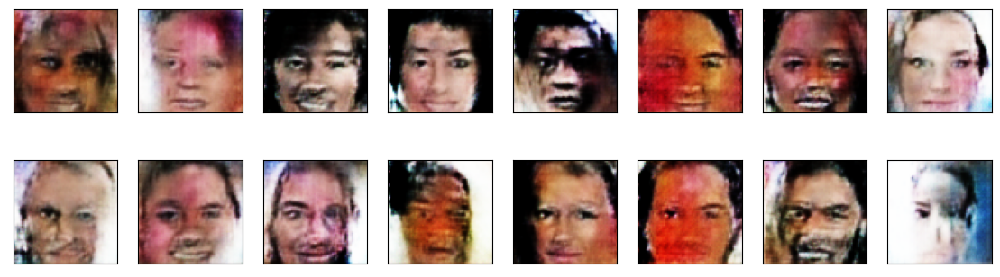

############  batch_i: 817
Generated images /  min: -1.0___max: 0.9973115
############  batch_i: 818
Generated images /  min: -1.0___max: 0.9983373
############  batch_i: 819
Generated images /  min: -1.0___max: 0.9976564
############  batch_i: 820
Generated images /  min: -1.0___max: 0.9742961
############  batch_i: 821
Generated images /  min: -1.0___max: 0.9826428
############  batch_i: 822
Generated images /  min: -1.0___max: 0.9841306
############  batch_i: 823
Generated images /  min: -1.0___max: 0.9893568
############  batch_i: 824
Generated images /  min: -1.0___max: 0.988168
############  batch_i: 825
Generated images /  min: -1.0___max: 0.99245304
############  batch_i: 826
Generated images /  min: -1.0___max: 0.9782135
############  batch_i: 827
Generated images /  min: -1.0___max: 0.9893037
############  batch_i: 828
Generated images /  min: -1.0___max: 0.98641276
############  batch_i: 829
Generated images /  min: -1.0___max: 0.9892912
############  batch_i: 830
Generated 

Generated images /  min: -1.0___max: 0.9898727
############  batch_i: 928
Generated images /  min: -1.0___max: 0.9876144
############  batch_i: 929
Generated images /  min: -1.0___max: 0.9913282
############  batch_i: 930
Generated images /  min: -1.0___max: 0.99273324
############  batch_i: 931
Generated images /  min: -1.0___max: 0.9838956
############  batch_i: 932
Generated images /  min: -1.0___max: 0.99583316
############  batch_i: 933
Generated images /  min: -1.0___max: 0.9888072
############  batch_i: 934
Generated images /  min: -1.0___max: 0.9937079
############  batch_i: 935
Generated images /  min: -1.0___max: 0.98407495
############  batch_i: 936
Generated images /  min: -1.0___max: 0.98468995
############  batch_i: 937
Generated images /  min: -1.0___max: 0.9833954
############  batch_i: 938
Generated images /  min: -1.0___max: 0.9733309
############  batch_i: 939
Generated images /  min: -1.0___max: 0.99538004
############  batch_i: 940
Generated images /  min: -1.0___m

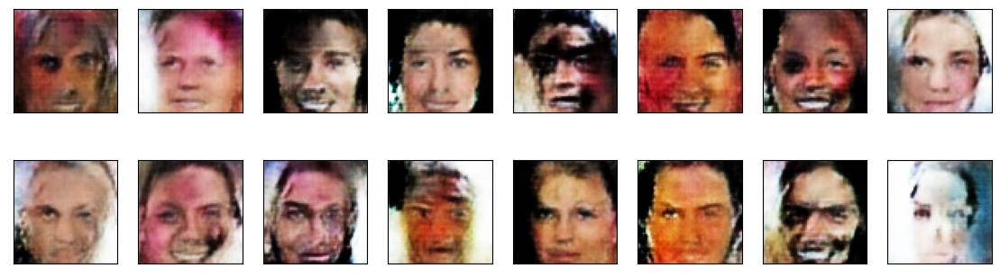

############  batch_i: 1
Generated images /  min: -1.0___max: 0.9868395
############  batch_i: 2
Generated images /  min: -1.0___max: 0.97891223
############  batch_i: 3
Generated images /  min: -1.0___max: 0.99448764
############  batch_i: 4
Generated images /  min: -1.0___max: 0.9844444
############  batch_i: 5


KeyboardInterrupt: 

In [37]:
# Main loop for training 

# BASED ON 'TRAINING A DEEP CONVOLUTIONAL GANS' SECTION - EXERCISE 'DCGAN TRAINING'

# creating generator, discriminator
generator = Generator(latent_dim).to(device)
#generator.load_state_dict(torch.load("t1_gen10.pt"))

discriminator = Discriminator(conv_dim).to(device)
#discriminator.load_state_dict(torch.load("t1_dis10.pt"))

# creating optimisers
g_optimizer = optim.Adam(generator.parameters(), lr, [beta1, beta2])
d_optimizer = optim.Adam(discriminator.parameters(), lr, [beta1, beta2])


#fixed_latent_vector = torch.randn(16, latent_dim, 1, 1).float().cuda()
fixed_latent_vector = torch.randn(16, latent_dim).float().cuda()

train_on_gpu = True
losses = []
for epoch in range(n_epochs):
    #for batch_i, real_images in enumerate(dataloader):
    for batch_i in range(0,1018):
        time = str(datetime.now()).split('.')[0]
        
        #print('############  batch_i: ' + str(batch_i), '________' + time)
        real_images = next(iter(dataloader))
        real_images = real_images.to(device)
        
        #print('e: '+str(epoch), 'b: '+str(batch_i))

        #print(real_images)
        ####################################
        batch_size = real_images.size(0)
        # TODO: implement the training strategy
        g_loss=generator_step(batch_size,latent_dim) 
        d_loss=discriminator_step(batch_size,latent_dim,real_images)
        ####################################
        
        if batch_i % print_every == 0:
            # append discriminator loss and generator loss
            d = d_loss['loss'].item()
            g = g_loss['loss'].item()
            losses.append((d, g))
            # print discriminator and generator loss
            
            print(f'{time} | Epoch [{epoch+1}/{n_epochs}] | Batch {batch_i}/{len(dataloader)} | d_loss: {d:.4f} | g_loss: {g:.4f}')
    
            gen_save_name = 'w1_gen1'+str(epoch)+'_'+str(batch_i)+'.pt'
            dis_save_name = 'w1_dis1'+str(epoch)+'_'+str(batch_i)+'.pt'
    
            torch.save(generator.state_dict(), gen_save_name)
            torch.save(discriminator.state_dict(), dis_save_name)
            
            with open('w1_losses'+ '_'+str(epoch)+'_'+str(batch_i) +'.npy', 'wb') as f:
                np.save(f, losses)    
    
            # display images during training
            generator.eval()
            generated_images = generator(fixed_latent_vector)
            display(generated_images)
            generator.train()

2023-05-01 23:18:43 | Epoch [1/10] | Batch 0/1018 | d_loss: 0.0373 | g_loss: 16.8586


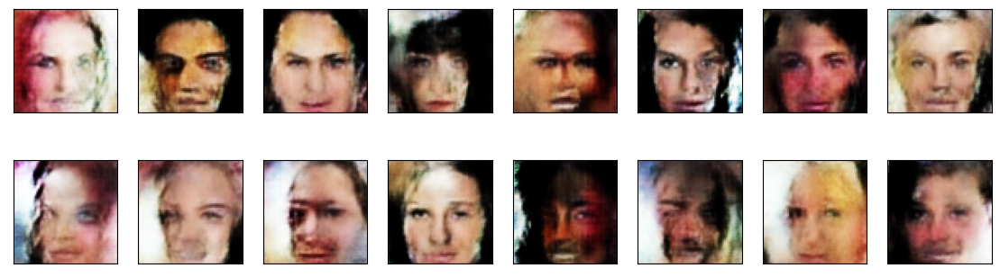

2023-05-01 23:48:39 | Epoch [1/10] | Batch 204/1018 | d_loss: 0.5154 | g_loss: 13.4420


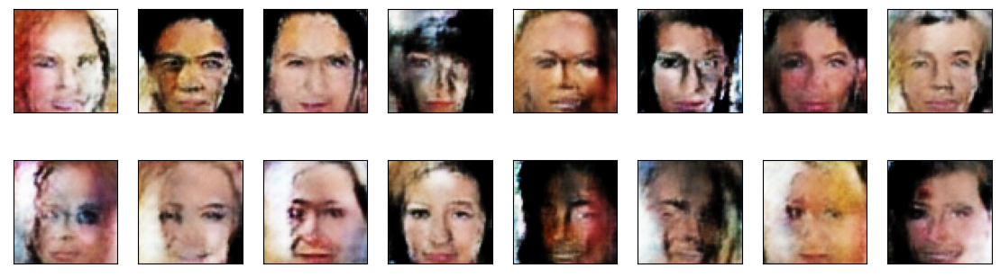

2023-05-02 00:18:52 | Epoch [1/10] | Batch 408/1018 | d_loss: 0.0010 | g_loss: 13.8612


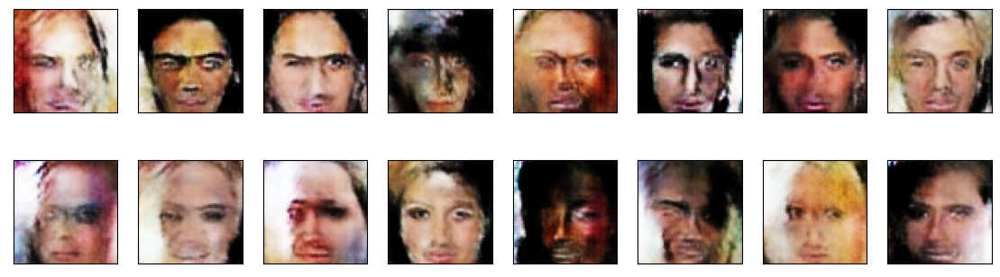

2023-05-02 00:49:09 | Epoch [1/10] | Batch 612/1018 | d_loss: 0.0520 | g_loss: 12.3581


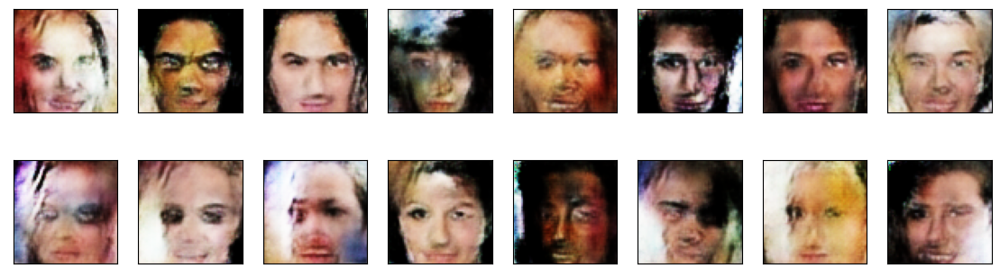

2023-05-02 01:19:21 | Epoch [1/10] | Batch 816/1018 | d_loss: 0.0530 | g_loss: 27.4478


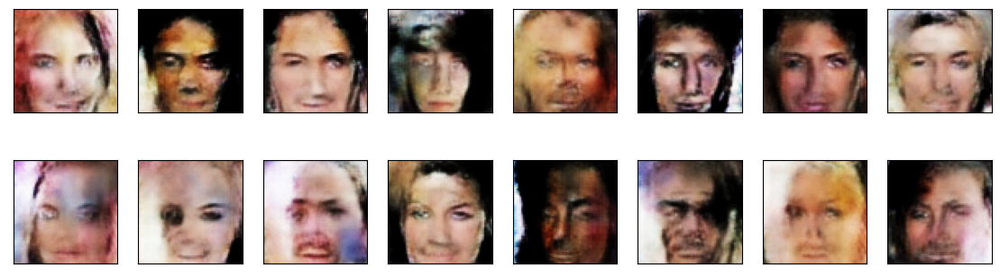

2023-05-02 01:49:34 | Epoch [2/10] | Batch 0/1018 | d_loss: 0.0000 | g_loss: 10.6618


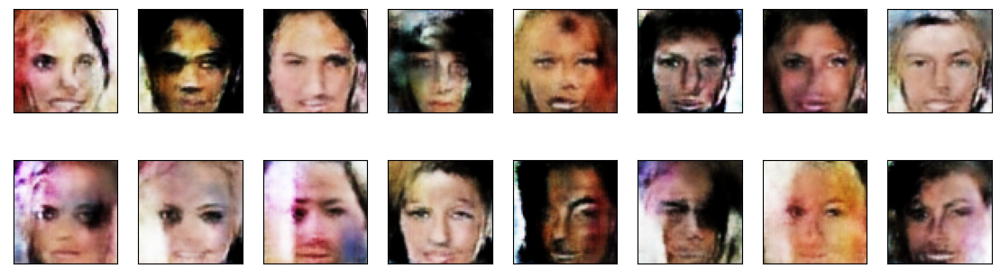

2023-05-02 02:20:08 | Epoch [2/10] | Batch 204/1018 | d_loss: 2.3443 | g_loss: 29.5960


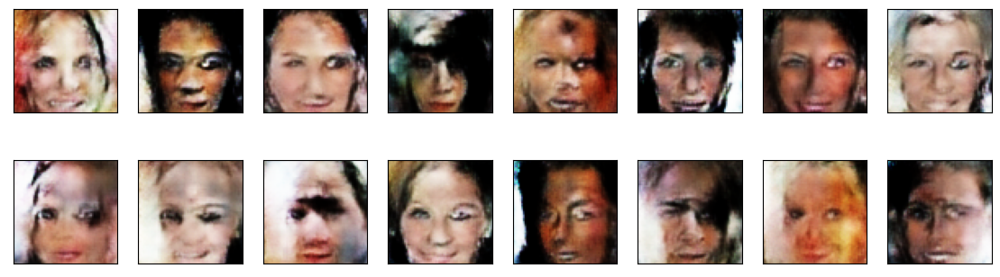

2023-05-02 02:50:21 | Epoch [2/10] | Batch 408/1018 | d_loss: 0.0000 | g_loss: 8.2674


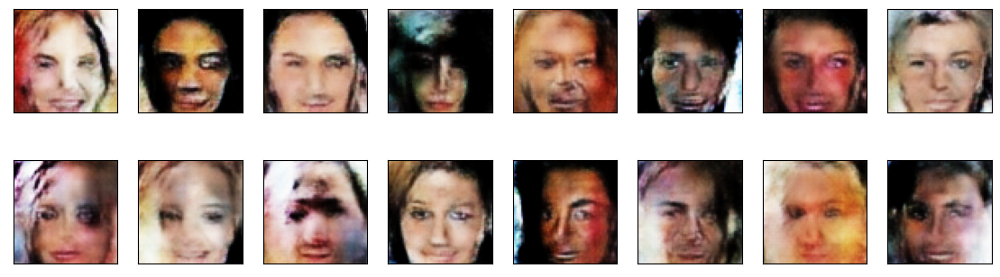

2023-05-02 03:20:33 | Epoch [2/10] | Batch 612/1018 | d_loss: 0.0032 | g_loss: 12.2157


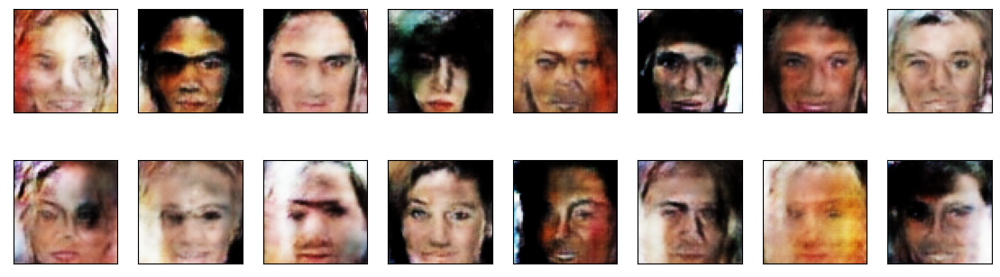

2023-05-02 03:50:48 | Epoch [2/10] | Batch 816/1018 | d_loss: 0.0002 | g_loss: 13.4965


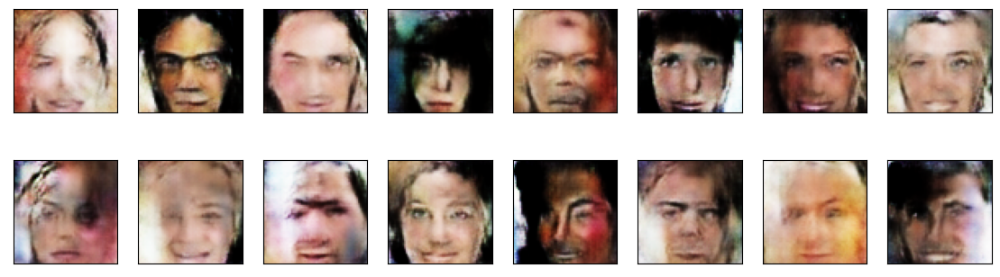

2023-05-02 04:20:41 | Epoch [3/10] | Batch 0/1018 | d_loss: 0.0041 | g_loss: 8.0562


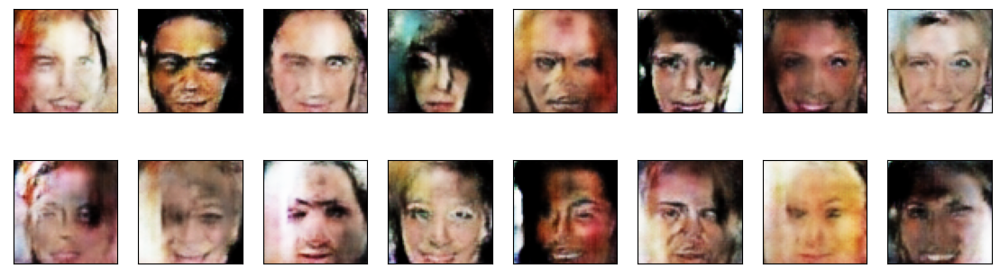

2023-05-02 04:50:51 | Epoch [3/10] | Batch 204/1018 | d_loss: 0.0001 | g_loss: 12.1130


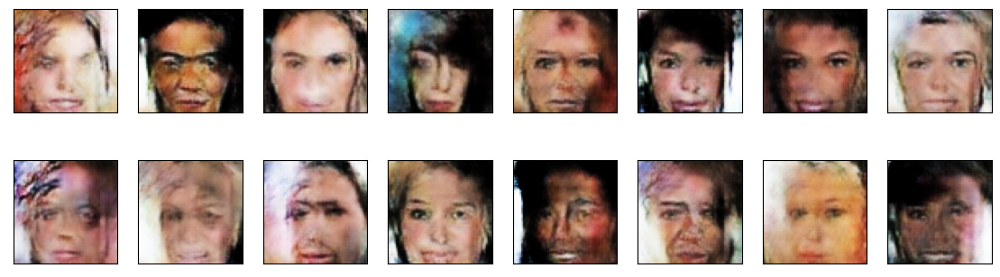

2023-05-02 05:21:01 | Epoch [3/10] | Batch 408/1018 | d_loss: 0.0002 | g_loss: 21.4141


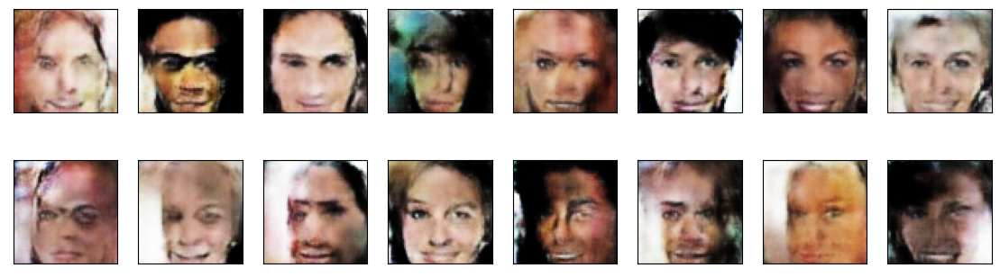

2023-05-02 05:51:07 | Epoch [3/10] | Batch 612/1018 | d_loss: 0.0000 | g_loss: 15.3924


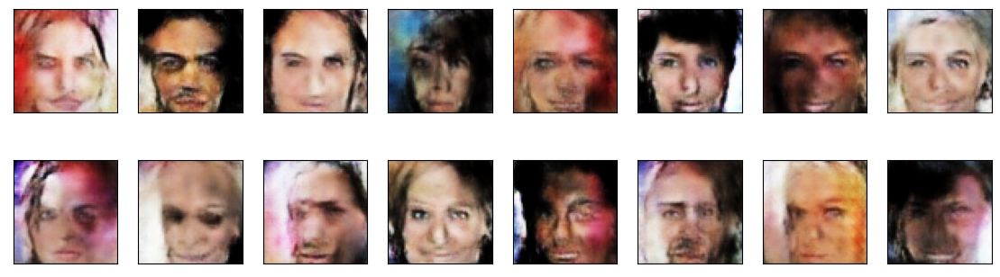

2023-05-02 06:21:17 | Epoch [3/10] | Batch 816/1018 | d_loss: 0.0042 | g_loss: 11.4988


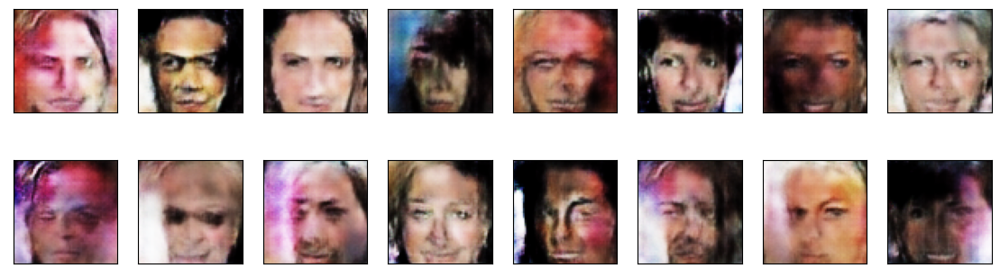

2023-05-02 06:51:08 | Epoch [4/10] | Batch 0/1018 | d_loss: 0.0001 | g_loss: 13.6973


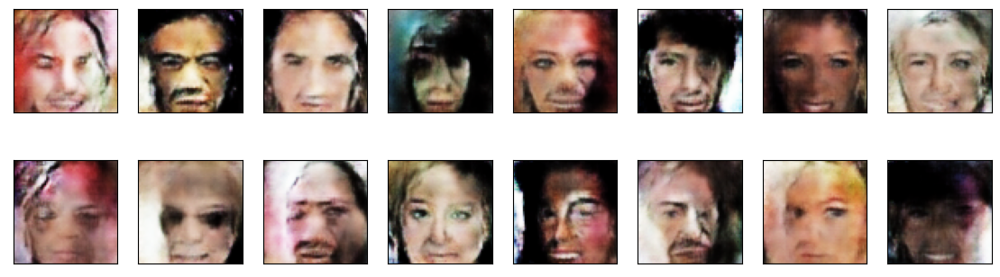

2023-05-02 07:21:19 | Epoch [4/10] | Batch 204/1018 | d_loss: 0.0020 | g_loss: 14.7671


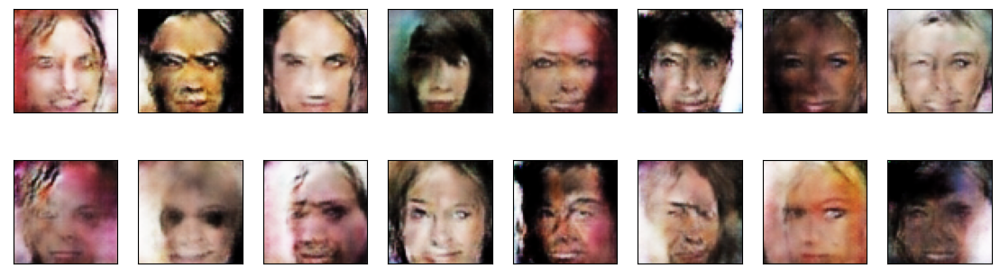

2023-05-02 07:51:26 | Epoch [4/10] | Batch 408/1018 | d_loss: 0.0007 | g_loss: 19.3356


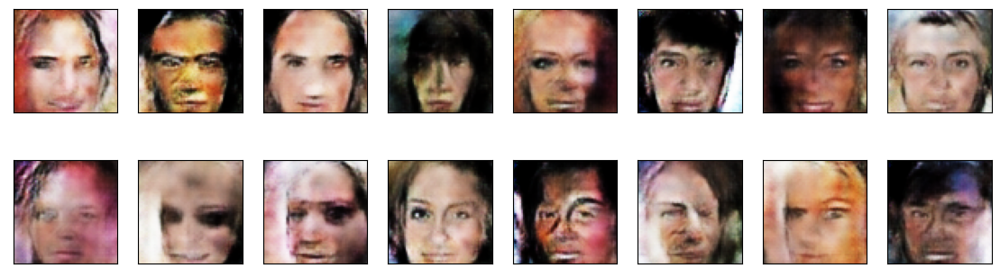

2023-05-02 08:21:37 | Epoch [4/10] | Batch 612/1018 | d_loss: 11.8576 | g_loss: 36.7002


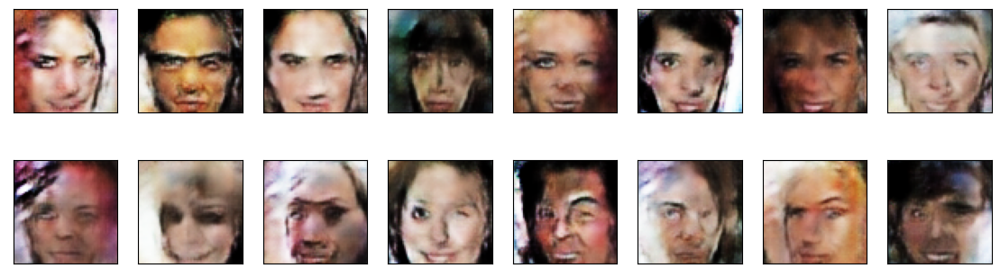

2023-05-02 08:51:56 | Epoch [4/10] | Batch 816/1018 | d_loss: 0.0000 | g_loss: 15.2288


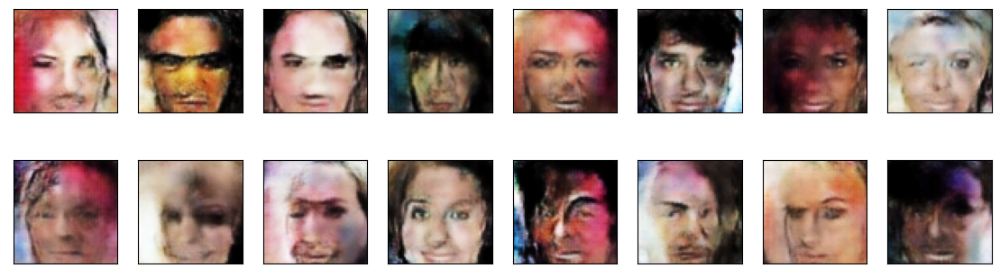

2023-05-02 09:21:48 | Epoch [5/10] | Batch 0/1018 | d_loss: 0.0034 | g_loss: 8.3230


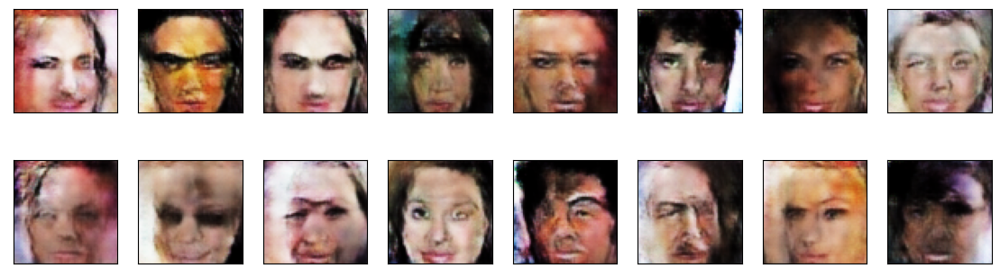

2023-05-02 09:51:23 | Epoch [5/10] | Batch 204/1018 | d_loss: 0.0000 | g_loss: 14.3570


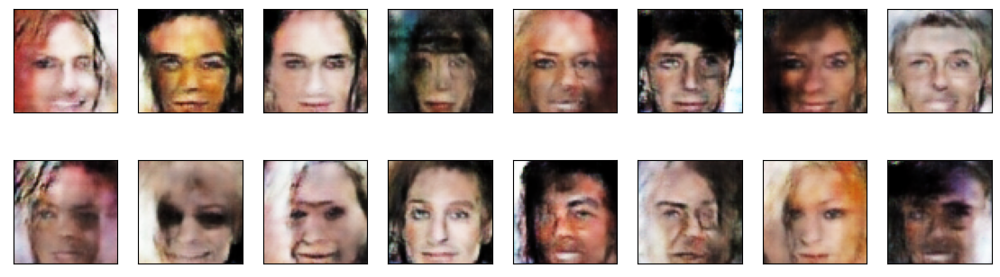

2023-05-02 10:20:56 | Epoch [5/10] | Batch 408/1018 | d_loss: 0.0015 | g_loss: 8.2575


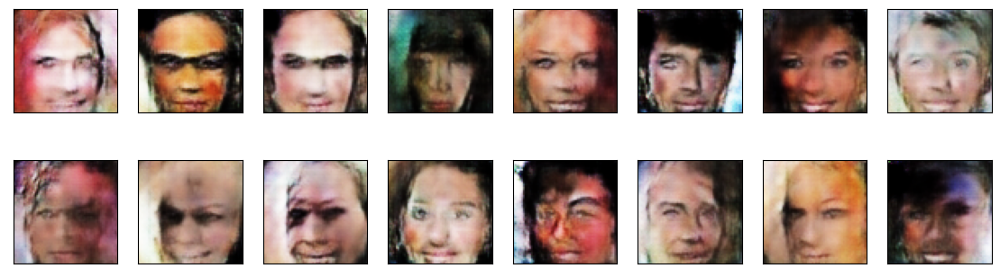

2023-05-02 10:50:32 | Epoch [5/10] | Batch 612/1018 | d_loss: 0.0012 | g_loss: 18.6106


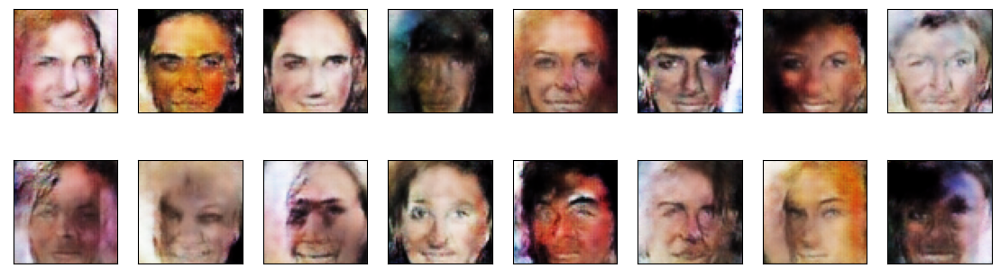

2023-05-02 11:20:13 | Epoch [5/10] | Batch 816/1018 | d_loss: 0.0470 | g_loss: 13.8212


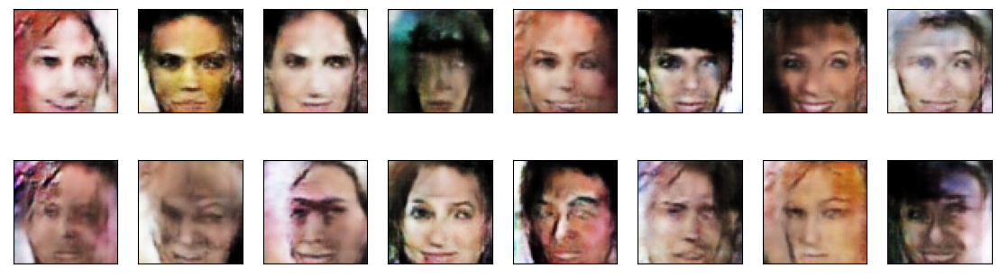

2023-05-02 11:49:41 | Epoch [6/10] | Batch 0/1018 | d_loss: 0.0001 | g_loss: 32.7093


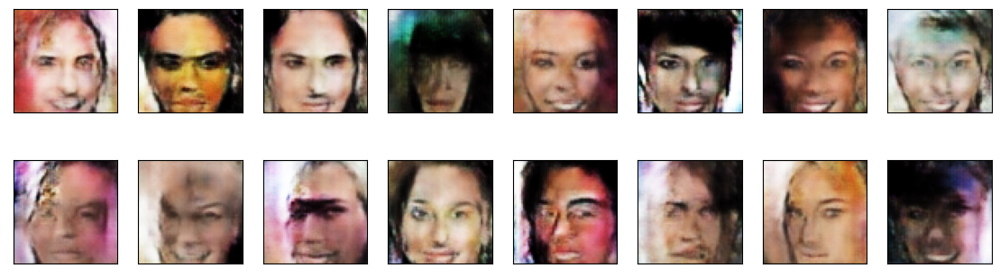

2023-05-02 12:19:29 | Epoch [6/10] | Batch 204/1018 | d_loss: 0.0076 | g_loss: 11.9468


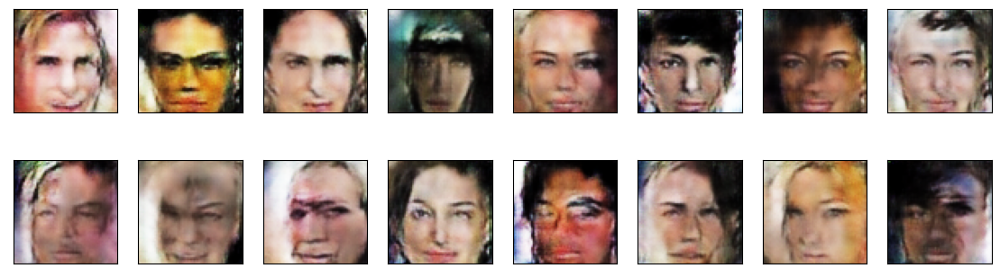

2023-05-02 12:49:26 | Epoch [6/10] | Batch 408/1018 | d_loss: 0.0000 | g_loss: 14.6665


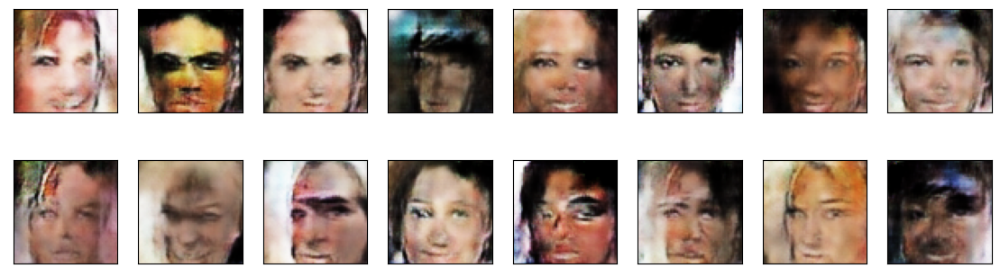

2023-05-02 13:19:12 | Epoch [6/10] | Batch 612/1018 | d_loss: 0.0056 | g_loss: 25.9095


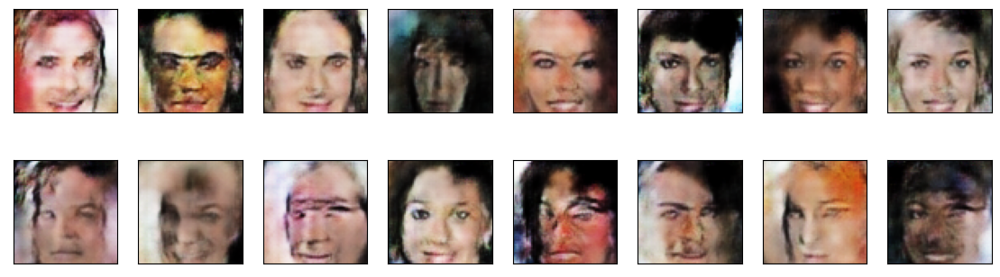

2023-05-02 13:48:47 | Epoch [6/10] | Batch 816/1018 | d_loss: 0.1075 | g_loss: 18.3833


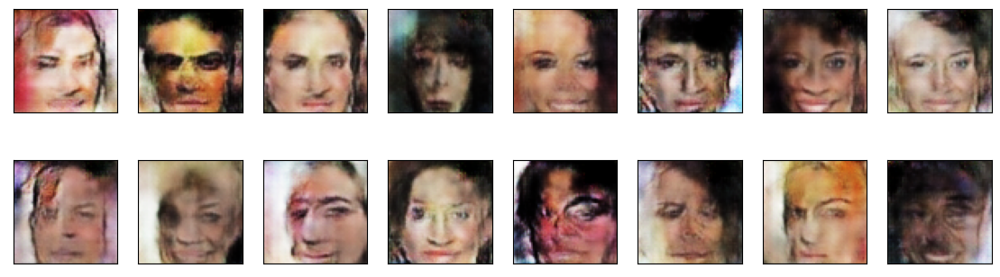

2023-05-02 14:18:02 | Epoch [7/10] | Batch 0/1018 | d_loss: 0.0327 | g_loss: 11.5889


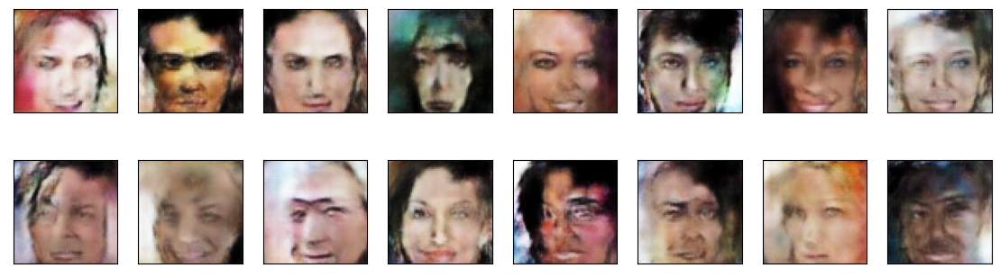

2023-05-02 14:47:44 | Epoch [7/10] | Batch 204/1018 | d_loss: 0.0002 | g_loss: 8.8825


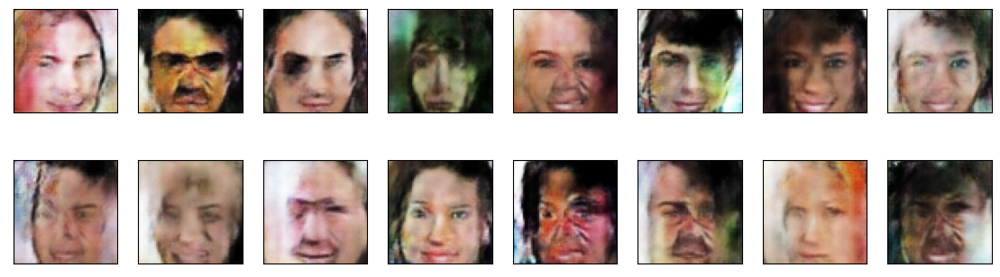

2023-05-02 15:17:55 | Epoch [7/10] | Batch 408/1018 | d_loss: 0.0000 | g_loss: 15.8729


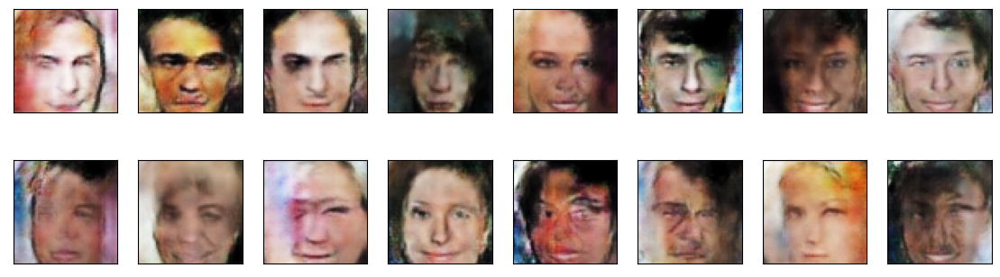

2023-05-02 15:48:03 | Epoch [7/10] | Batch 612/1018 | d_loss: 0.0000 | g_loss: 22.8476


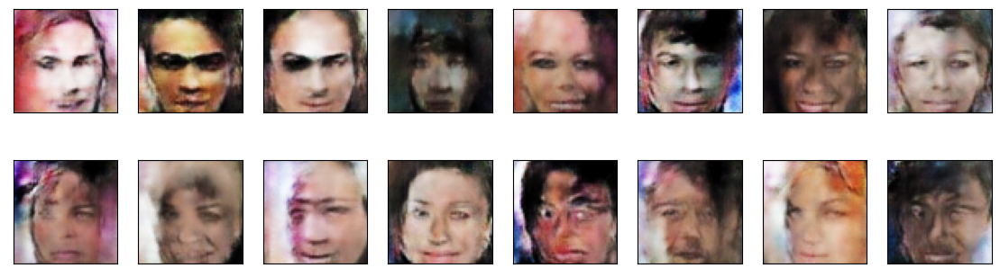

2023-05-02 16:18:15 | Epoch [7/10] | Batch 816/1018 | d_loss: 0.0001 | g_loss: 13.7110


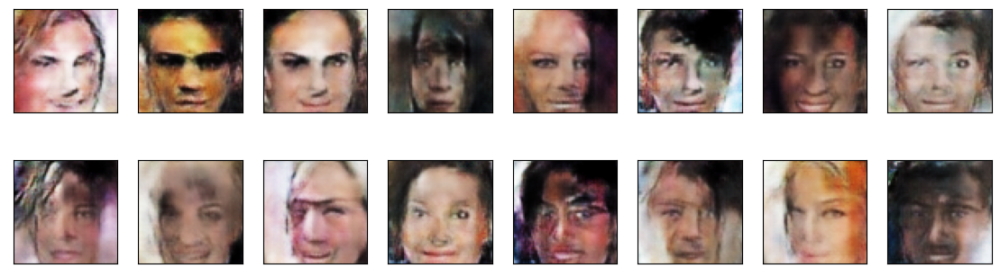

2023-05-02 16:48:05 | Epoch [8/10] | Batch 0/1018 | d_loss: 0.0001 | g_loss: 15.7428


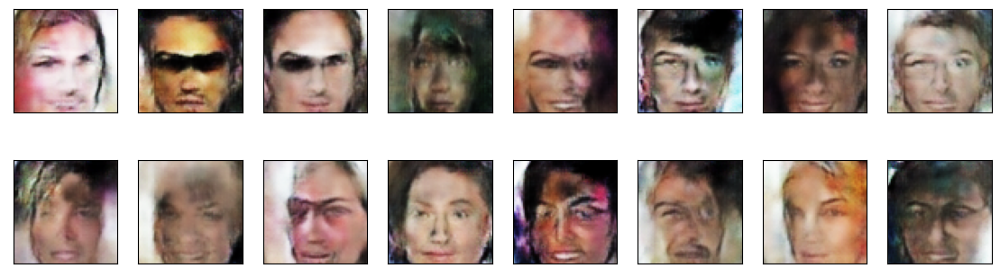

2023-05-02 17:18:17 | Epoch [8/10] | Batch 204/1018 | d_loss: 0.0000 | g_loss: 15.5681


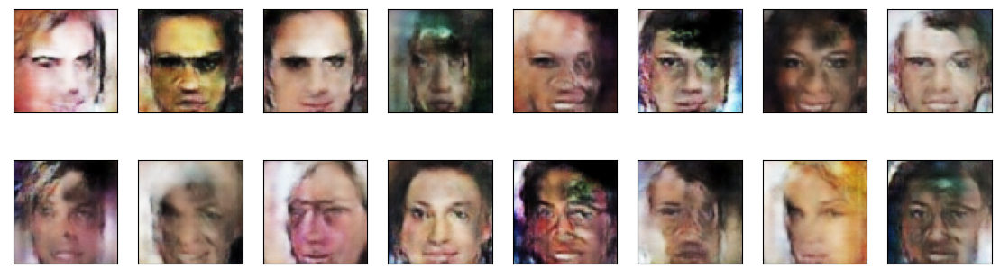

2023-05-02 17:48:29 | Epoch [8/10] | Batch 408/1018 | d_loss: 0.0000 | g_loss: 14.4826


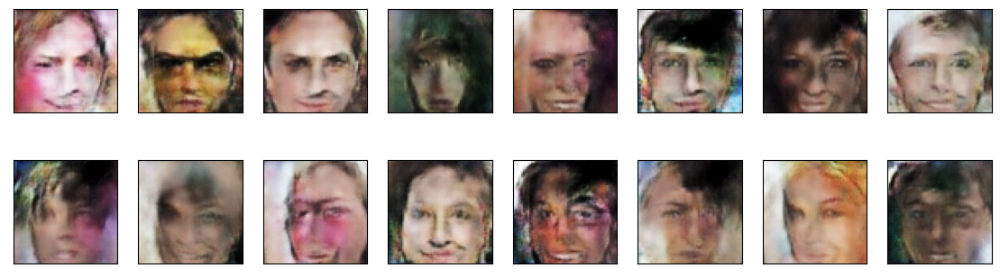

2023-05-02 18:18:35 | Epoch [8/10] | Batch 612/1018 | d_loss: 0.0002 | g_loss: 19.4280


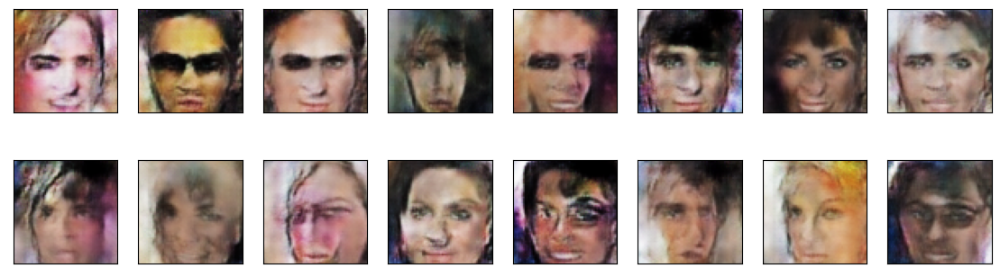

2023-05-02 18:48:39 | Epoch [8/10] | Batch 816/1018 | d_loss: 0.0005 | g_loss: 20.6284


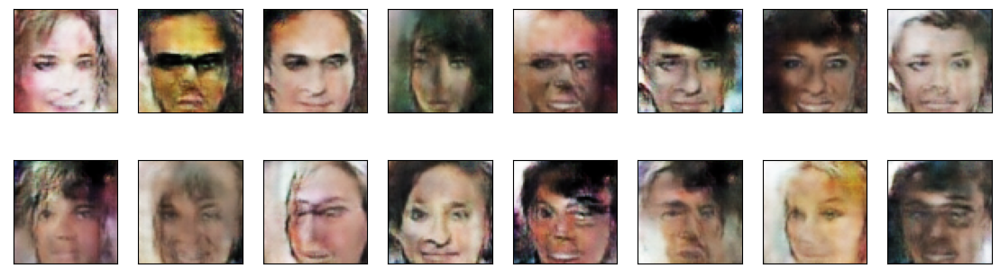

2023-05-02 19:18:28 | Epoch [9/10] | Batch 0/1018 | d_loss: 0.0001 | g_loss: 20.9018


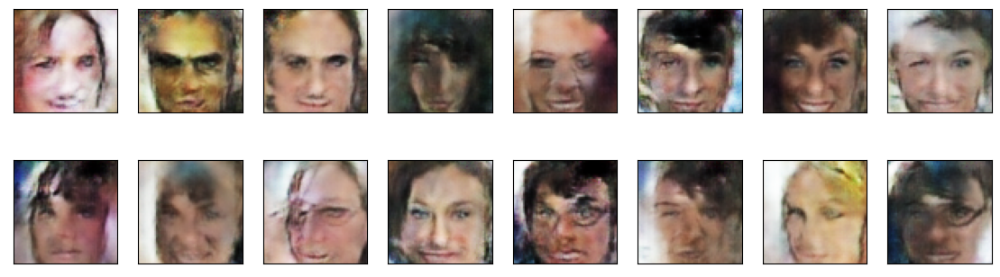

2023-05-02 19:48:33 | Epoch [9/10] | Batch 204/1018 | d_loss: 0.0000 | g_loss: 9.4098


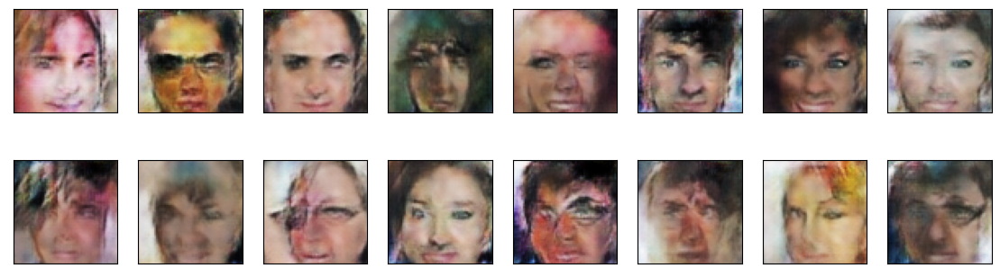

2023-05-02 20:18:41 | Epoch [9/10] | Batch 408/1018 | d_loss: 0.0004 | g_loss: 19.0198


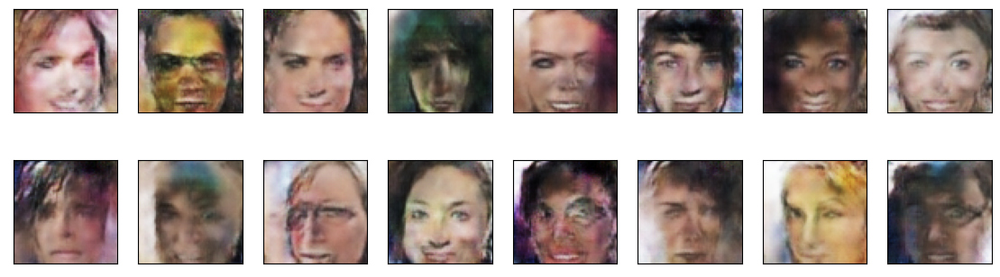

In [ ]:
# BASED ON 'TRAINING A DEEP CONVOLUTIONAL GANS' SECTION - EXERCISE 'DCGAN TRAINING'

dataloader = DataLoader(dataset, 
                        batch_size=batch_size, 
                        shuffle=True, 
                        num_workers=0, 
                        drop_last=True,
                        pin_memory=False)


generator = Generator(latent_dim).to(device)
generator.load_state_dict(torch.load("w1_gen13_0.pt"))

discriminator = Discriminator(conv_dim).to(device)
discriminator.load_state_dict(torch.load("w1_dis13_0.pt"))

g_optimizer = optim.Adam(generator.parameters(), lr, [beta1, beta2])
d_optimizer = optim.Adam(discriminator.parameters(), lr, [beta1, beta2])


#fixed_latent_vector = torch.randn(16, latent_dim, 1, 1).float().cuda()
fixed_latent_vector = torch.randn(16, latent_dim).float().cuda()

train_on_gpu = True
losses = []
for epoch in range(n_epochs):
    #for batch_i, real_images in enumerate(dataloader):
    for batch_i in range(0,1018):
        time = str(datetime.now()).split('.')[0]
        
        # print('############  batch_i: ' + str(batch_i), '________' + time)
        real_images = next(iter(dataloader))
        real_images = real_images.to(device)
        
        #print('e: '+str(epoch), 'b: '+str(batch_i))

        #print(real_images)
        ####################################
        batch_size = real_images.size(0)
        # TODO: implement the training strategy
        g_loss=generator_step(batch_size,latent_dim) 
        d_loss=discriminator_step(batch_size,latent_dim,real_images)
        ####################################
        
        if batch_i % print_every == 0:
            # append discriminator loss and generator loss
            d = d_loss['loss'].item()
            g = g_loss['loss'].item()
            losses.append((d, g))
            # print discriminator and generator loss
            
            print(f'{time} | Epoch [{epoch+1}/{n_epochs}] | Batch {batch_i}/{len(dataloader)} | d_loss: {d:.4f} | g_loss: {g:.4f}')
    
            gen_save_name = 'w2_gen1'+str(epoch)+'_'+str(batch_i)+'.pt'
            dis_save_name = 'w2_dis1'+str(epoch)+'_'+str(batch_i)+'.pt'
    
            torch.save(generator.state_dict(), gen_save_name)
            torch.save(discriminator.state_dict(), dis_save_name)
            
            with open('w2_losses'+ '_'+str(epoch)+'_'+str(batch_i) +'.npy', 'wb') as f:
                np.save(f, losses)    
    
            # display images during training
            generator.eval()
            generated_images = generator(fixed_latent_vector)
            display(generated_images)
            generator.train()

# Question: What do you notice about your generated samples and how might you improve this model?
When you answer this question, consider the following factors:
- The dataset is biased; it is made of "celebrity" faces that are mostly white
- Model size; larger models have the opportunity to learn more features in a data feature space
- Optimization strategy; optimizers and number of epochs affect your final result
- Loss functions

Here are some thoughts about the dataset and the model development:
1) As it is stated in the question, the dataset is biased towards white celebrity people who are represented with simmetrical and attractive faces. The develpoped model will struggle to generate faces for other races or less good looking subpopulations. 

2) Larger convolutional model are able to identify/generate more fine features on the image hence better resolution of images should be reached with higher expresive capacity models

3) Increasing b1 and decreasing batch size from 64 to 32 decreased the number of artifacts on the generated faces. Increasing the number of epochs allows to generate images with better resolution (though overfitting can happen too). I have read also that using SGD optimiser for discriminator and ADAM optimiserfor generator can improve the performance of the GAN 

4) Using smoothing loss improves the performance of the GAN